In [1]:
%matplotlib notebook
import numpy as np
import matplotlib.pyplot as plt
import datetime
import glob
import netCDF4
import xarray as xr
import pandas as pd
import seaborn as sns
plt.style.use('seaborn')

C:\Users\pkoll\AppData\Local\Temp\ipykernel_4300\4031092812.py:10: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn')


In [2]:
#### MIGHTI ####
# MIGHTI data is packaged once per image, so one file every 30 or 60 seconds.
# Grab all the data from the 3:00-4:00 UT on Jan 2, 2020 (Note that we want to use the latest version and revision which for this day is v03r001, but that's not always true)
L1m_fns = glob.glob('/disks/data/icon/Repository/Archive/LEVEL.1/MIGHTI-A/2020/002/Data/ICON_L1_MIGHTI-A_Science_2020-01-02_03????_v03r001.NC')
L1m_fns.sort()

#### FUV ####
# FUV data is packaged once per day
# Latest is v05
# We're using SWP which means short-wave (i.e. 135.6 nm) profile
L1f_fn = 'ICON_L1_FUV_SWP_2020-01-02_v05r001.NC'

In [4]:
L1m_fns

[]

In [5]:
L1f_fn


'ICON_L1_FUV_SWP_2020-01-02_v05r001.NC'

In [6]:
#LOADING IN THE DATA
dsf_raw = xr.open_dataset(L1f_fn,engine = 'netcdf4')
dsf_raw


<xarray.Dataset>
Dimensions:                            (Epoch: 5745, Rows: 256, Stripes: 6)
Coordinates:
  * Epoch                              (Epoch) float64 1.578e+12 ... 1.578e+12
  * Rows                               (Rows) float32 0.0 1.0 ... 254.0 255.0
Dimensions without coordinates: Stripes
Data variables: (12/52)
    ICON_L1_FUVA_SWP_Start_Times       (Epoch) object ...
    ICON_L1_FUVA_SWP_Stop_Times        (Epoch) object ...
    ICON_L1_FUVA_SWP_Center_Times      (Epoch) object ...
    ICON_L1_FUVA_SWP_Integration_Time  (Epoch) float32 ...
    ICON_L1_FUVA_SWP_Chain_ID          (Epoch) float32 ...
    ICON_L1_FUVA_SWP_Quality_Flag      (Epoch) float32 ...
    ...                                 ...
    ICON_L1_FUVA_SWP_PROF_M3_CLEAN     (Epoch, Rows) float32 ...
    ICON_L1_FUVA_SWP_PROF_P0_CLEAN     (Epoch, Rows) float32 ...
    ICON_L1_FUVA_SWP_PROF_P3_CLEAN     (Epoch, Rows) float32 ...
    ICON_L1_FUVA_SWP_PROF_P6_CLEAN     (Epoch, Rows) float32 ...
    ICON_L1_FUVA_SWP_GAIN_DAY          (Stripes) float32 ...
    ICON_L1_FUVA_SWP_GAIN_NIGHT        (Stripes) float32 ...
Attributes: (12/51)
    Acknowledgement:             This is a data product from the NASA Ionosph...
    ADID_Ref:                    NASA Contract > NNG12F45C
    Calibration_File:            See calibration files in general attribute f...
    Conventions:                 SPDF ISTP/IACF Modified for NetCDF (v0.8)
    Data_Level:                  L1
    Data_Type:                   APIDxE3 > ICON Application ID 0xE3: FUV Scie...
    ...                          ...
    FLATFIELD_CORRECTION:        [1.159 1.057 1.011 0.952 0.919 0.91 ]
    BACKGROUND_CORRECTION:       BKG/ICON_L1_FUV_Calibration-Background-SW_20...
    RAYLEIGH_CONVERSION:         [0.04132972 0.04132972 0.04132972 ... 0.0413...
    File_Date:                   Thu, 11 May 2023, 2023-05-11T20:23:20.071 UTC
    Generation_Date:             20230511
    Software_Version:            ICON SDC > ICON FUV L1 Processor version 202...

In [6]:
# Downselect the data to only include the variables we are concerned with.
# For now just use the 4th stripe (out of 6, labeled P0), and just use time and the calibrated brightness 
dsf = dsf_raw[['ICON_L1_FUVA_SWP_Center_Times','ICON_L1_FUVA_SWP_PROF_P0']]  # IF STARS BECOME A PROBLEM, USE THE CLEAN VERSION
# Convert times to something Python and xarray can understand, and reindex the dataset by time instead of the obscure "Epoch"
t = pd.to_datetime(dsf.ICON_L1_FUVA_SWP_Center_Times.values)
dsf['time'] = (['Epoch'], t)
dsf = dsf.swap_dims({'Epoch':'time'})
dsf = dsf.rename({'Rows':'row'})
# Rename and drop useless variables
dsf['I_1356'] = dsf['ICON_L1_FUVA_SWP_PROF_P0']
dsf = dsf.drop(['ICON_L1_FUVA_SWP_PROF_P0','ICON_L1_FUVA_SWP_Center_Times','Epoch'])

In [7]:
dsf


<xarray.Dataset>
Dimensions:  (row: 256, time: 5745)
Coordinates:
  * row      (row) float32 0.0 1.0 2.0 3.0 4.0 ... 251.0 252.0 253.0 254.0 255.0
  * time     (time) datetime64[ns] 2020-01-02T00:00:09.588000 ... 2020-01-02T...
Data variables:
    I_1356   (time, row) float32 ...
Attributes: (12/51)
    Acknowledgement:             This is a data product from the NASA Ionosph...
    ADID_Ref:                    NASA Contract > NNG12F45C
    Calibration_File:            See calibration files in general attribute f...
    Conventions:                 SPDF ISTP/IACF Modified for NetCDF (v0.8)
    Data_Level:                  L1
    Data_Type:                   APIDxE3 > ICON Application ID 0xE3: FUV Scie...
    ...                          ...
    FLATFIELD_CORRECTION:        [1.159 1.057 1.011 0.952 0.919 0.91 ]
    BACKGROUND_CORRECTION:       BKG/ICON_L1_FUV_Calibration-Background-SW_20...
    RAYLEIGH_CONVERSION:         [0.04132972 0.04132972 0.04132972 ... 0.0413...
    File_Date:                   Thu, 11 May 2023, 2023-05-11T20:23:20.071 UTC
    Generation_Date:             20230511
    Software_Version:            ICON SDC > ICON FUV L1 Processor version 202...

<IPython.core.display.Javascript object>


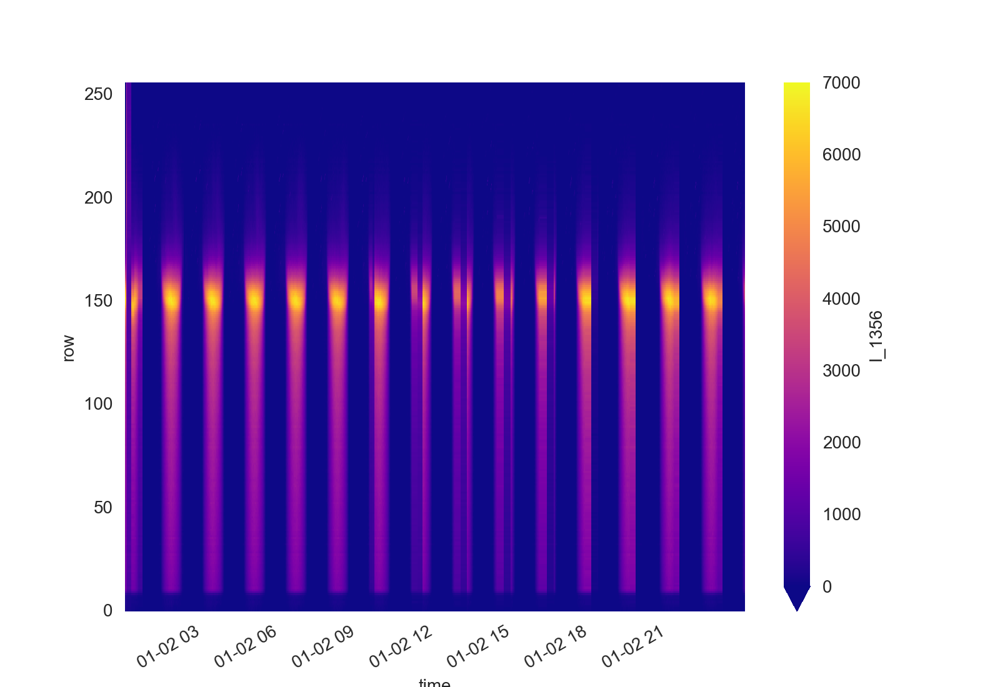

In [8]:
# Let's just plot 3-4 UT to match up with the hour we're loading of MIGHTI data
# (I picked 3-4 UT because it covers one dayside pass. You'll have to load a lot of orbits and improve the analysis of course)
ds_to_plot = dsf.sel()

plt.figure()
ds_to_plot.I_1356.T.plot(vmin=0, vmax=7000, cmap='plasma')

<IPython.core.display.Javascript object>


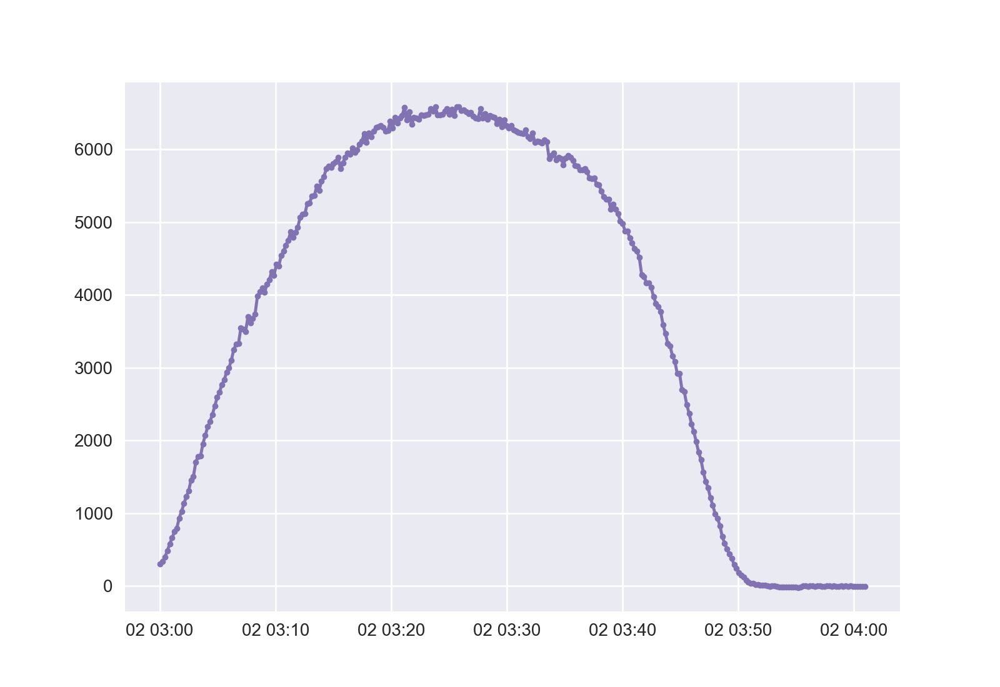

In [10]:
dsf2 = dsf.isel(row=148).sel(time=slice('2020-01-02 3:00', '2020-01-02 4:00')) # FUV at row 148 and 03:00-04:00 (I have no idea if this is the right row/altitude)

plt.figure()
plt.plot(dsf2.time, dsf2.I_1356, 'C3.-') # 10x factor is just for convenience- removed for now
plt.show()

<IPython.core.display.Javascript object>


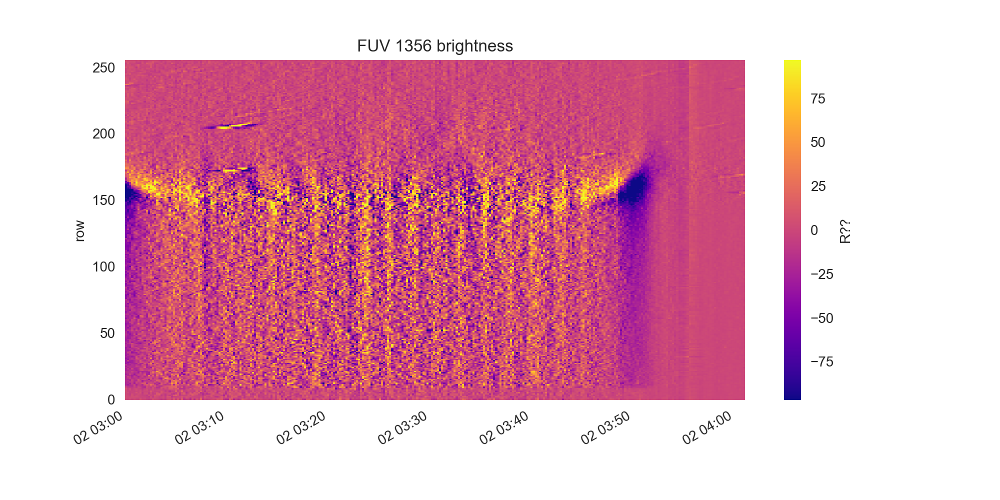

In [11]:
#FILTERING
dsf['I_1356_filt'] = dsf['I_1356'] - dsf['I_1356'].rolling(time=17, center=True).mean() # Remove ~3.5 minute (17-sample) rolling mean (FUV samples @ 12 sec)

# Which data to plot

dsf_plot = dsf.sel(time=slice('2020-01-02 3:00', '2020-01-02 4:00'))

plt.figure(figsize=(10,5))

# FUV
vm = abs(dsf_plot.I_1356_filt).quantile(0.99) # Choose max of colorbar (i.e., contrast)
plt.pcolormesh(pd.to_datetime(dsf_plot.time.values), dsf_plot.row, dsf_plot.I_1356_filt.T, cmap='plasma', vmin=-vm, vmax=vm)
plt.ylabel('row')
plt.colorbar(label='R??')
plt.title('FUV 1356 brightness')


plt.gcf().autofmt_xdate() 
# plt.colorbar(
plt.show()

<IPython.core.display.Javascript object>


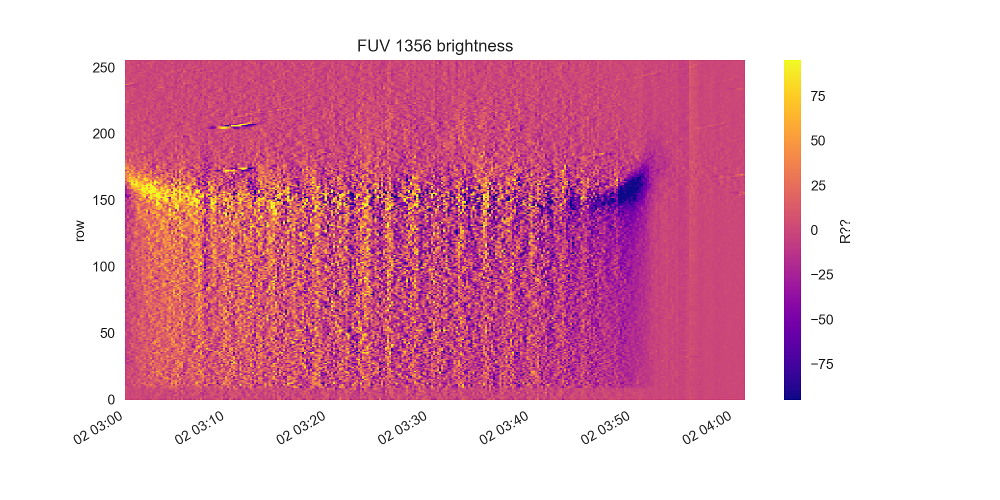

In [11]:
#FILTERING
dsf['I_1356_filt'] = dsf['I_1356'] - dsf['I_1356'].rolling(time=12, center=True).mean() # Remove ~3.5 minute (17-sample) rolling mean (FUV samples @ 12 sec)

# Which data to plot

dsf_plot = dsf.sel(time=slice('2020-01-02 3:00', '2020-01-02 4:00'))

plt.figure(figsize=(10,5))

# FUV
vm = abs(dsf_plot.I_1356_filt).quantile(0.99) # Choose max of colorbar (i.e., contrast)
plt.pcolormesh(pd.to_datetime(dsf_plot.time.values), dsf_plot.row, dsf_plot.I_1356_filt.T, cmap='plasma', vmin=-vm, vmax=vm)
plt.ylabel('row')
plt.colorbar(label='R??')
plt.title('FUV 1356 brightness')


plt.gcf().autofmt_xdate()
# plt.colorbar()
plt.show()

<IPython.core.display.Javascript object>


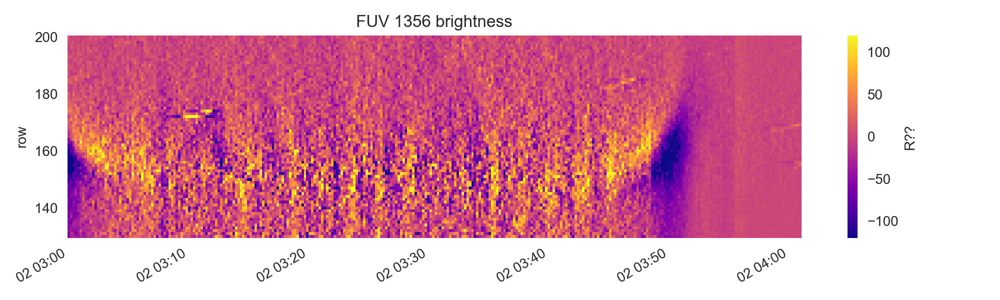

In [12]:
# Alt Match
# Which data to plot
dsf_plot = dsf.sel(time=slice('2020-01-02 3:00', '2020-01-02 4:00'), row=slice(130,200))

plt.figure(figsize=(10,3))
vm = abs(dsf_plot.I_1356_filt).quantile(0.99) # Choose max of colorbar (i.e., contrast)
plt.pcolormesh(pd.to_datetime(dsf_plot.time.values), dsf_plot.row, dsf_plot.I_1356_filt.T, cmap='plasma', vmin=-vm, vmax=vm)
plt.ylabel('row')
plt.colorbar(label='R??')
plt.title('FUV 1356 brightness')

plt.gcf().autofmt_xdate()
plt.tight_layout()


<IPython.core.display.Javascript object>


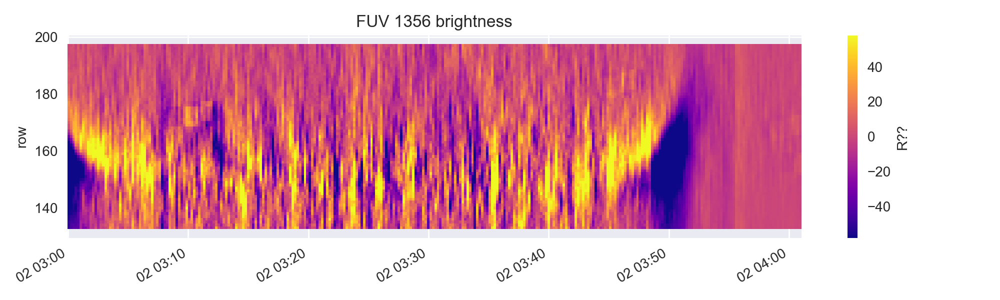

In [13]:
#SMOOTHED
# Which data to plot
dsf_plot = dsf.sel(time=slice('2020-01-02 3:00', '2020-01-02 4:00'), row=slice(130,200))
dsf_plot = dsf_plot.rolling(row=7, center=True).mean()

plt.figure(figsize=(10,3))

# FUV
vm = abs(dsf_plot.I_1356_filt).quantile(0.95) # Choose max of colorbar (i.e., contrast)
plt.pcolormesh(pd.to_datetime(dsf_plot.time.values), dsf_plot.row, dsf_plot.I_1356_filt.T, cmap='plasma', vmin=-vm, vmax=vm)
plt.ylabel('row')
plt.colorbar(label='R??')
plt.title('FUV 1356 brightness')

plt.gcf().autofmt_xdate()
plt.tight_layout()

## ORBITS FROM THE SAME DAY

<IPython.core.display.Javascript object>


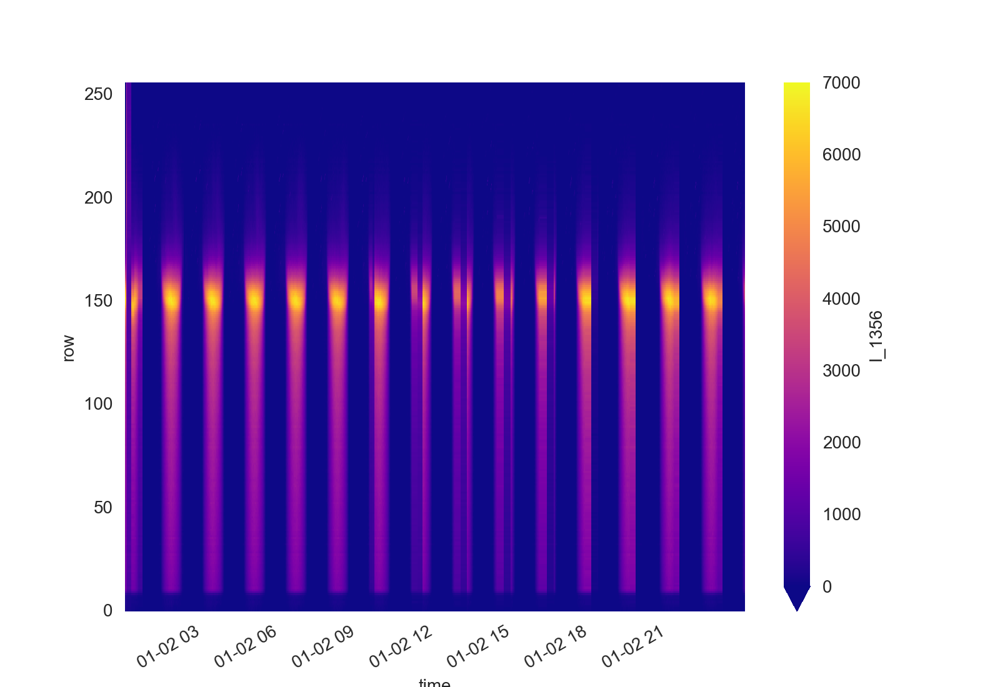

In [14]:
ds_to_plot = dsf.sel()

plt.figure()
ds_to_plot.I_1356.T.plot(vmin=0, vmax=7000, cmap='plasma')


<IPython.core.display.Javascript object>


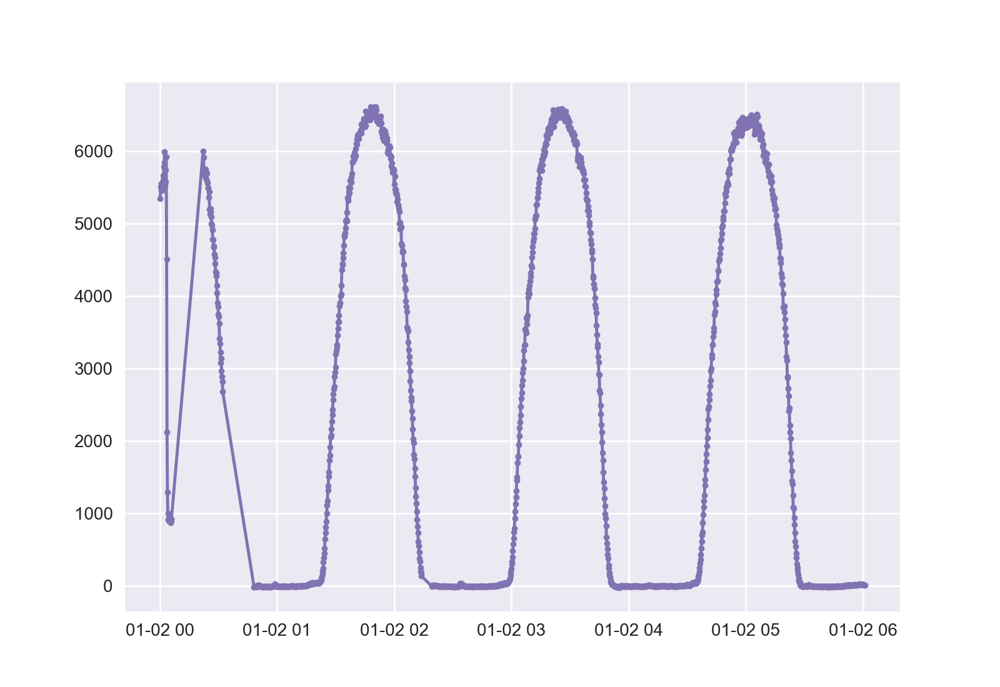

In [19]:
dsf2 = dsf.isel(row=148).sel(time=slice('2020-01-02 0:00', '2020-01-02 6:00')) # FUV at row 148 and 03:00-04:00 (I have no idea if this is the right row/altitude)
#originally was 148


times = []

for i in range(0,len (dsf2)):
    if dsf2.I_1356 > 0:
        times.append(dsf2.time)
    
plt.figure()
plt.plot(dsf2.time, dsf2.I_1356, 'C3.-') # 10x factor is just for convenience- removed for now
plt.show()

In [46]:
all_points_more0 = []

for i in range(0,len(dsf2.I_1356)):
    if dsf2.I_1356[i].to_numpy()> 0:
        all_points_more0.append(dsf2.I_1356.to_numpy()[i])
        #times.append(dsf2.time)
        #print (times)

In [42]:
dsf2

<xarray.Dataset>
Dimensions:      (time: 1579)
Coordinates:
    row          float32 148.0
  * time         (time) datetime64[ns] 2020-01-02T00:00:09.588000 ... 2020-01...
Data variables:
    I_1356       (time) float32 5.343e+03 5.512e+03 5.468e+03 ... 12.18 10.78
    I_1356_filt  (time) float32 nan nan nan nan ... 1.549 -7.871 -4.597 -5.483
Attributes: (12/51)
    Acknowledgement:             This is a data product from the NASA Ionosph...
    ADID_Ref:                    NASA Contract > NNG12F45C
    Calibration_File:            See calibration files in general attribute f...
    Conventions:                 SPDF ISTP/IACF Modified for NetCDF (v0.8)
    Data_Level:                  L1
    Data_Type:                   APIDxE3 > ICON Application ID 0xE3: FUV Scie...
    ...                          ...
    FLATFIELD_CORRECTION:        [1.159 1.057 1.011 0.952 0.919 0.91 ]
    BACKGROUND_CORRECTION:       BKG/ICON_L1_FUV_Calibration-Background-SW_20...
    RAYLEIGH_CONVERSION:         [0.04132972 0.04132972 0.04132972 ... 0.0413...
    File_Date:                   Thu, 11 May 2023, 2023-05-11T20:23:20.071 UTC
    Generation_Date:             20230511
    Software_Version:            ICON SDC > ICON FUV L1 Processor version 202...

### DIFFERENT DAYS

In [3]:
L1f_fn_01 = 'ICON_L1_FUV_SWP_2020-01-01_v05r000.NC'
L1f_fn_02 = 'ICON_L1_FUV_SWP_2020-01-02_v05r001.NC'
L1f_fn_03 = 'ICON_L1_FUV_SWP_2020-01-03_v05r000.NC'
L1f_fn_04 = 'ICON_L1_FUV_SWP_2020-01-04_v05r000.NC'
L1f_fn_18 = 'ICON_L1_FUV_SWP_2020-01-18_v05r000.NC'

In [4]:
# Downselect the data to only include the variables we are concerned with.
# For now just use the 4th stripe (out of 6, labeled P0), and just use time and the calibrated brightness 


def data_opening(d):
    dsf_raw = xr.open_dataset(d,engine = 'netcdf4')
    dsf = dsf_raw[['ICON_L1_FUVA_SWP_Center_Times','ICON_L1_FUVA_SWP_PROF_P0']]
    # Convert times to something Python and xarray can understand, and reindex the dataset by time instead of the obscure "Epoch"
    t = pd.to_datetime(dsf.ICON_L1_FUVA_SWP_Center_Times.values)
    dsf['time'] = (['Epoch'], t)
    dsf = dsf.swap_dims({'Epoch':'time'})
    dsf = dsf.rename({'Rows':'row'})
    # Rename and drop useless variables
    dsf['I_1356'] = dsf['ICON_L1_FUVA_SWP_PROF_P0']
    dsf = dsf.drop(['ICON_L1_FUVA_SWP_PROF_P0','ICON_L1_FUVA_SWP_Center_Times','Epoch'])
    return dsf

In [5]:
df_01 = data_opening(L1f_fn_01)

In [6]:
df_02 = data_opening(L1f_fn_02)

In [7]:
df_03 = data_opening(L1f_fn_03)
df_04 = data_opening(L1f_fn_04)
df_18 = data_opening(L1f_fn_18)

In [13]:
df_01

<xarray.Dataset>
Dimensions:  (row: 256, time: 5812)
Coordinates:
  * row      (row) float32 0.0 1.0 2.0 3.0 4.0 ... 251.0 252.0 253.0 254.0 255.0
  * time     (time) datetime64[ns] 2020-01-01T00:00:07.713000 ... 2020-01-01T...
Data variables:
    I_1356   (time, row) float32 ...
Attributes: (12/51)
    Acknowledgement:             This is a data product from the NASA Ionosph...
    ADID_Ref:                    NASA Contract > NNG12F45C
    Calibration_File:            See calibration files in general attribute f...
    Conventions:                 SPDF ISTP/IACF Modified for NetCDF (v0.8)
    Data_Level:                  L1
    Data_Type:                   APIDxE3 > ICON Application ID 0xE3: FUV Scie...
    ...                          ...
    FLATFIELD_CORRECTION:        [1.159 1.057 1.011 0.952 0.919 0.91 ]
    BACKGROUND_CORRECTION:       BKG/ICON_L1_FUV_Calibration-Background-SW_20...
    RAYLEIGH_CONVERSION:         [0.04132072 0.04132072 0.04132072 ... 0.0413...
    File_Date:                   Thu, 28 Apr 2022, 2022-04-28T22:23:12.626 UTC
    Generation_Date:             20220428
    Software_Version:            ICON SDC > ICON FUV L1 Processor version 202...

<IPython.core.display.Javascript object>


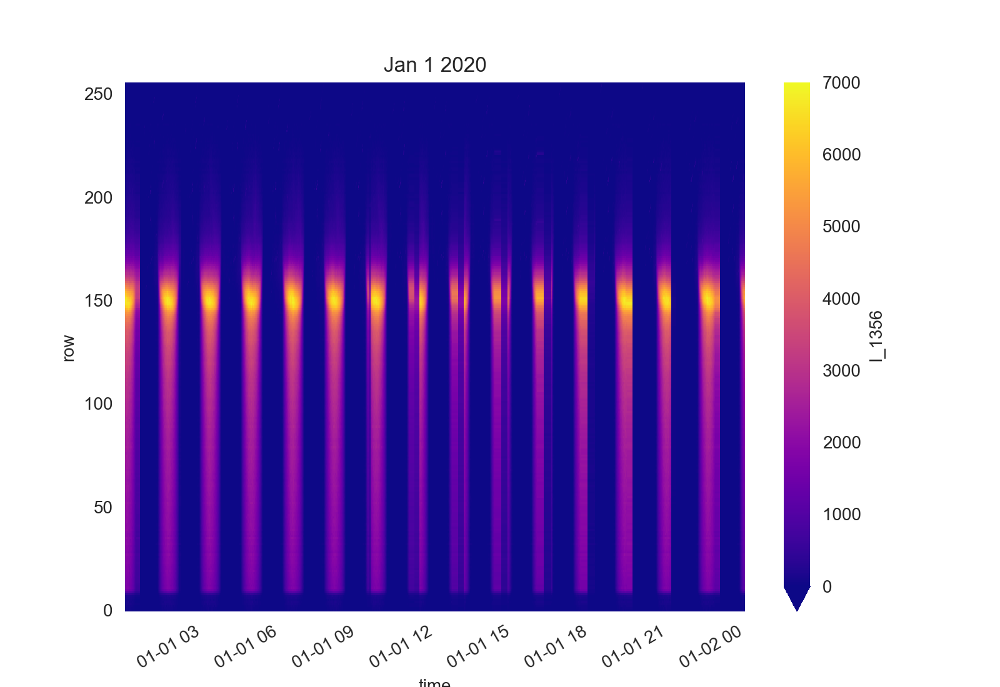

In [70]:
#ds_to_plot = 
plt.figure()
df_01.I_1356.T.plot(vmin=0, vmax=7000, cmap='plasma')
plt.title('Jan 1 2020')
plt.show()
plt.savefig('Jan1_all.png')

<IPython.core.display.Javascript object>


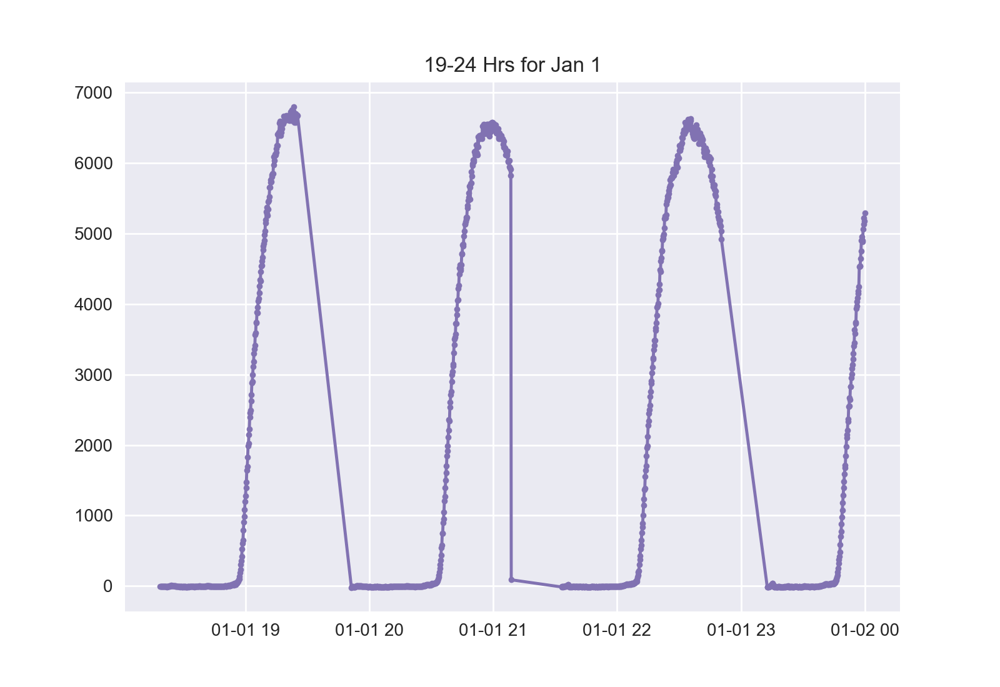

In [71]:
df_01_range = df_01.isel(row = 148).isel(time = slice(4500,5812))
plt.figure()
plt.title('19-24 Hrs for Jan 1')
plt.plot(df_01_range.time, df_01_range.I_1356, 'C3.-') # 10x factor is just for convenience- removed for now
plt.show()
plt.savefig('Jan1_1924_unfilled.png')

<IPython.core.display.Javascript object>


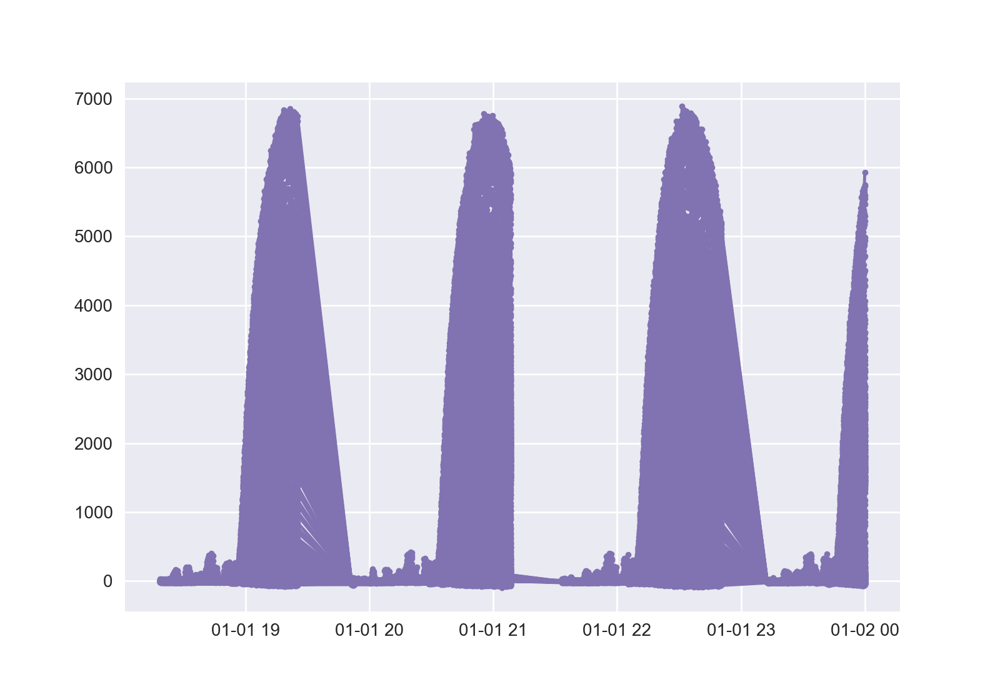

In [72]:
df_01_range = df_01.isel(time = slice(4500,5812))
plt.figure()
plt.plot(df_01_range.time, df_01_range.I_1356, 'C3.-') # 10x factor is just for convenience- removed for now
plt.show()
plt.savefig('Jan1_1924filled.png')

In [30]:
dsf2 = dsf.sel(time=slice('2020-01-02 0:00', '2020-01-02 6:00')) # FUV at row 148 and 03:00-04:00 (I have no idea if this is the right row/altitude)
dsf2.I_1356

<xarray.DataArray 'I_1356' (time: 1579, row: 256)>
[404224 values with dtype=float32]
Coordinates:
  * row      (row) float32 0.0 1.0 2.0 3.0 4.0 ... 251.0 252.0 253.0 254.0 255.0
  * time     (time) datetime64[ns] 2020-01-02T00:00:09.588000 ... 2020-01-02T...
Attributes: (12/19)
    TYPE:          float (4-bytes)
    CATDESC:       FUVA SW channel altitude column brightness for 0 to +3 deg...
    CONTENT:       FUVA SW channel altitude column brightness for 0 to +3 deg...
    DEPEND_0:      Epoch
    DEPEND_1:      Rows
    DISPLAY_TYPE:  spectrogram
    ...            ...
    VAR_TYPE:      data
    SCALETYP:      linear
    VAR_NOTES:     Vertical profile for 0 to +3 degrees FOV
    Valid_Min:     -1000000.0
    Valid_Max:     1000000.0
    Time_Base:     FIXED: 1970-01-01 UTC

<IPython.core.display.Javascript object>


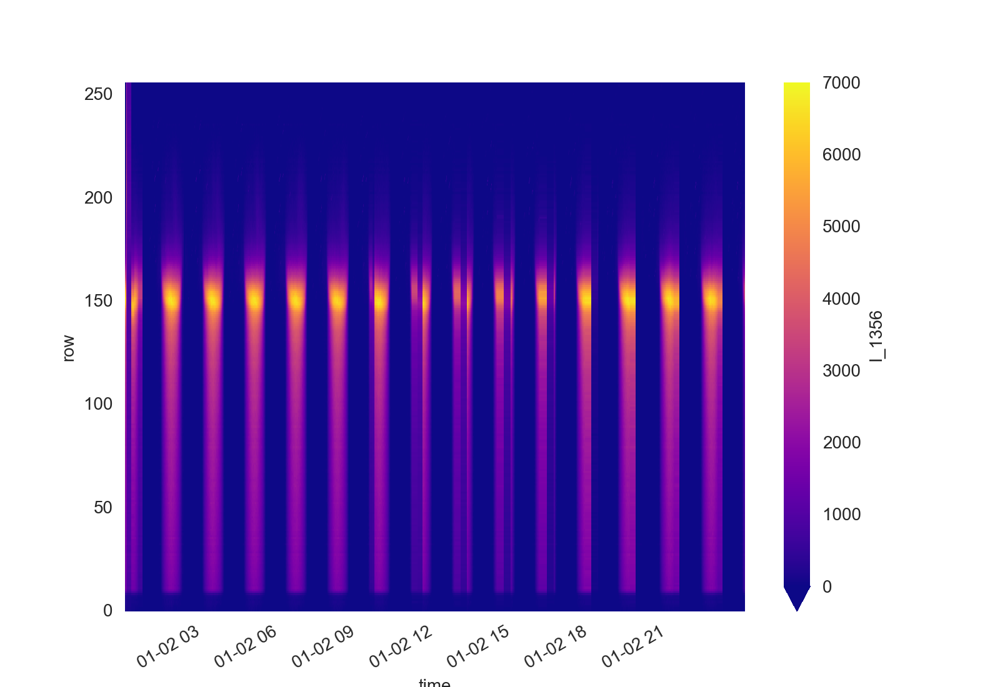

In [73]:
plt.figure()
plt.title('Jan 2 2020')
df_02.I_1356.T.plot(vmin=0, vmax=7000, cmap='plasma')
plt.show()
plt.savefig('Jan2_all.png')

<IPython.core.display.Javascript object>


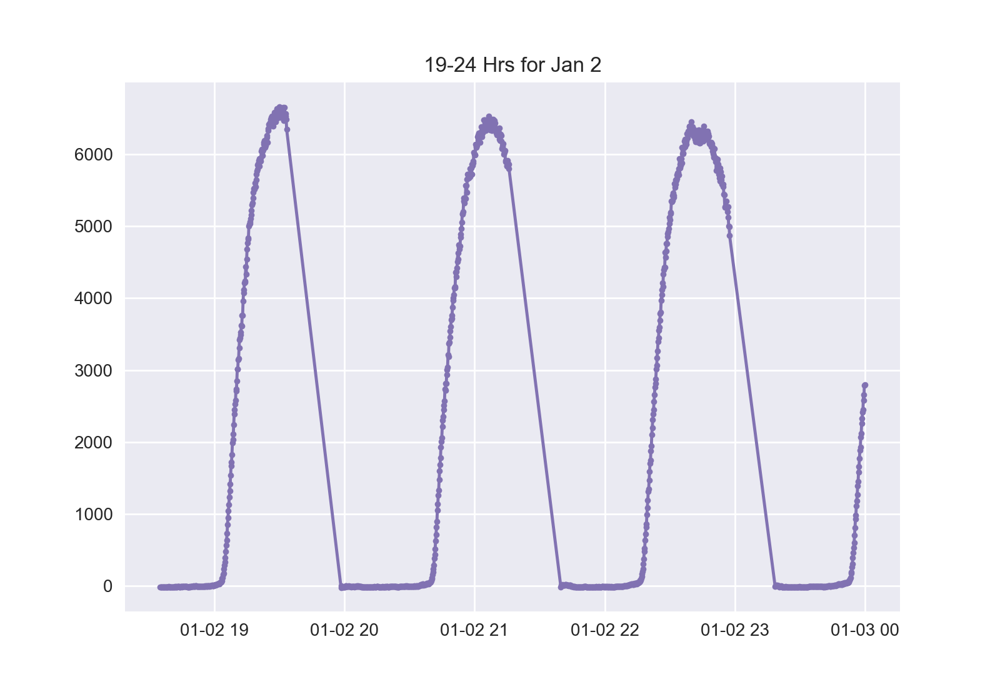

In [74]:
df_02_range = df_02.isel(row = 148).isel(time = slice(4500,5812))
plt.figure()
plt.title('19-24 Hrs for Jan 2')
plt.plot(df_02_range.time, df_02_range.I_1356, 'C3.-') # 10x factor is just for convenience- removed for now
plt.show()
plt.savefig('Jan2_1924_unfilled.png')

<IPython.core.display.Javascript object>


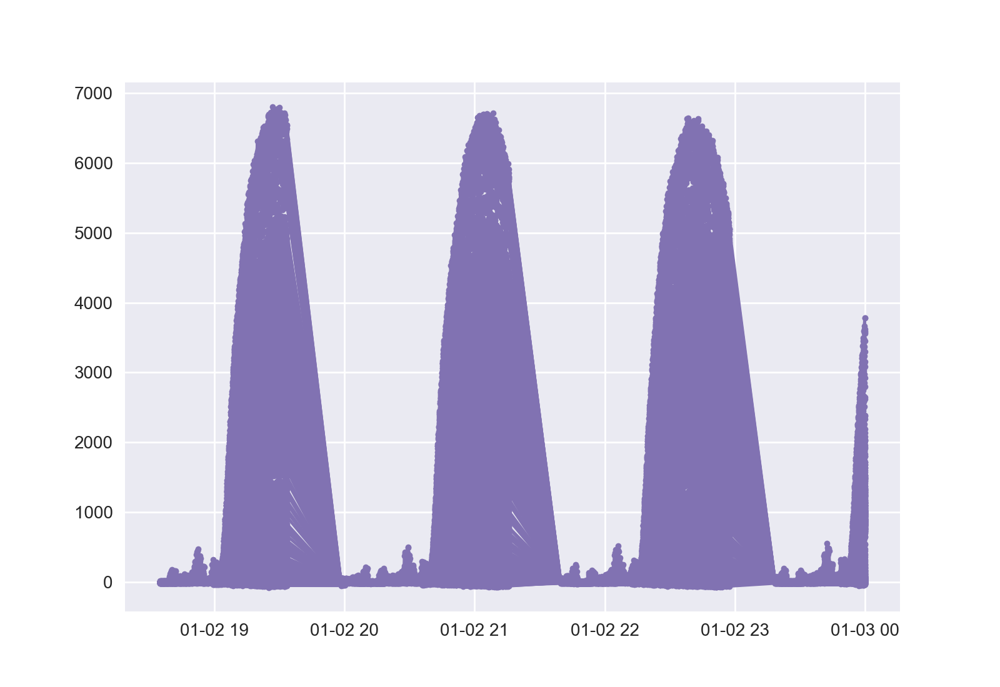

In [75]:
df_02_range = df_02.isel(time = slice(4500,5812))
plt.figure()
plt.plot(df_02_range.time, df_02_range.I_1356, 'C3.-') # 10x factor is just for convenience- removed for now
plt.show()
plt.savefig('Jan2_1924_filled.png')

<IPython.core.display.Javascript object>


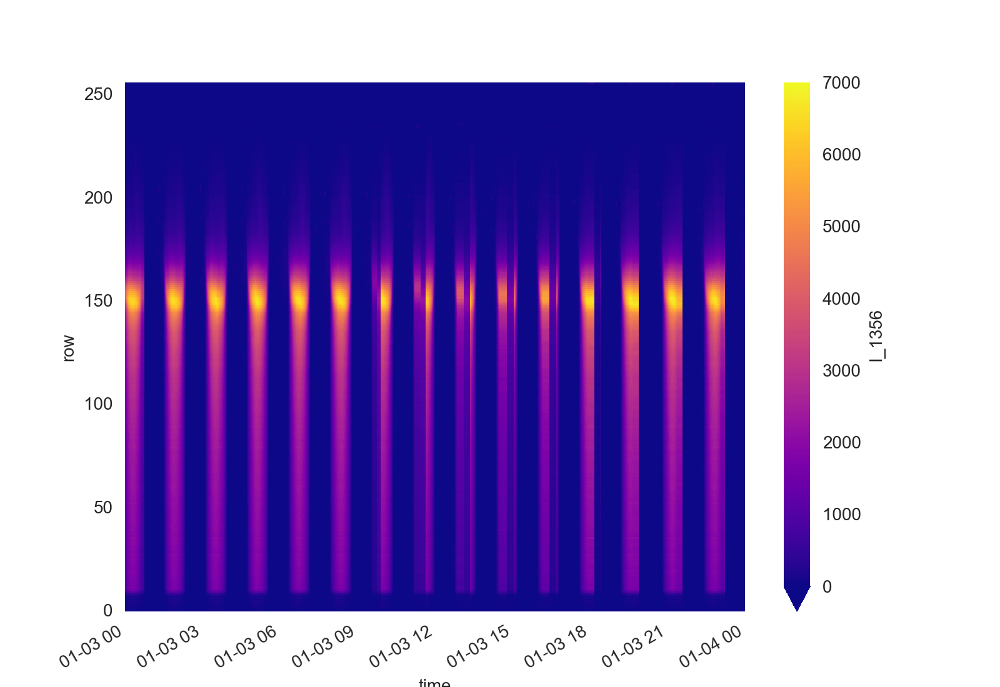

In [76]:
plt.figure()
plt.title('Jan 3 2020')
df_03.I_1356.T.plot(vmin=0, vmax=7000, cmap='plasma')
plt.show()
plt.savefig('Jan3_all.png')

<IPython.core.display.Javascript object>


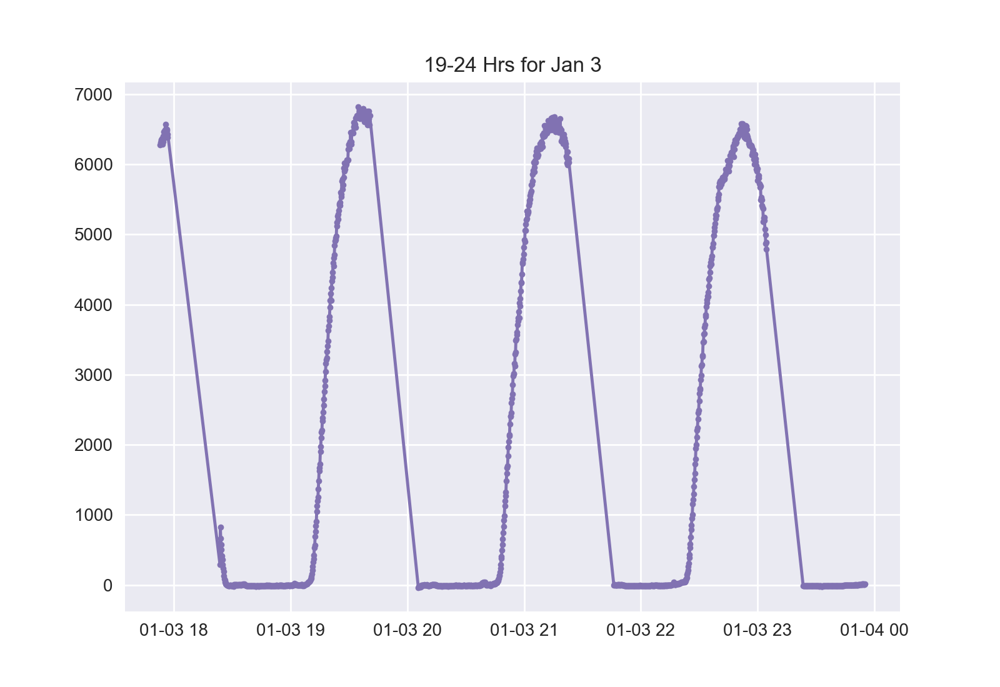

In [77]:
df_03_range = df_03.isel(row = 148).isel(time = slice(4500,5812))
plt.figure()
plt.title('19-24 Hrs for Jan 3')
plt.plot(df_03_range.time, df_03_range.I_1356, 'C3.-') # 10x factor is just for convenience- removed for now
plt.show()
plt.savefig('Jan3_1924_unfilled.png')

<IPython.core.display.Javascript object>


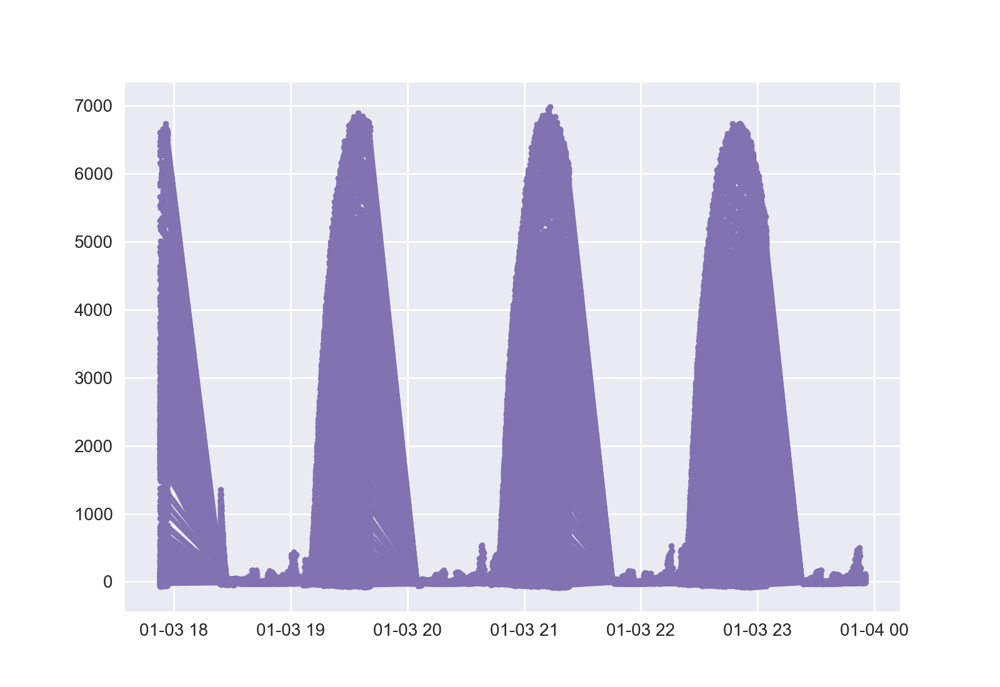

In [78]:
df_03_range = df_03.isel(time = slice(4500,5812))
plt.figure()
plt.plot(df_03_range.time, df_03_range.I_1356, 'C3.-') # 10x factor is just for convenience- removed for now
plt.show()
plt.savefig('Jan3_1924_filled.png')

<IPython.core.display.Javascript object>


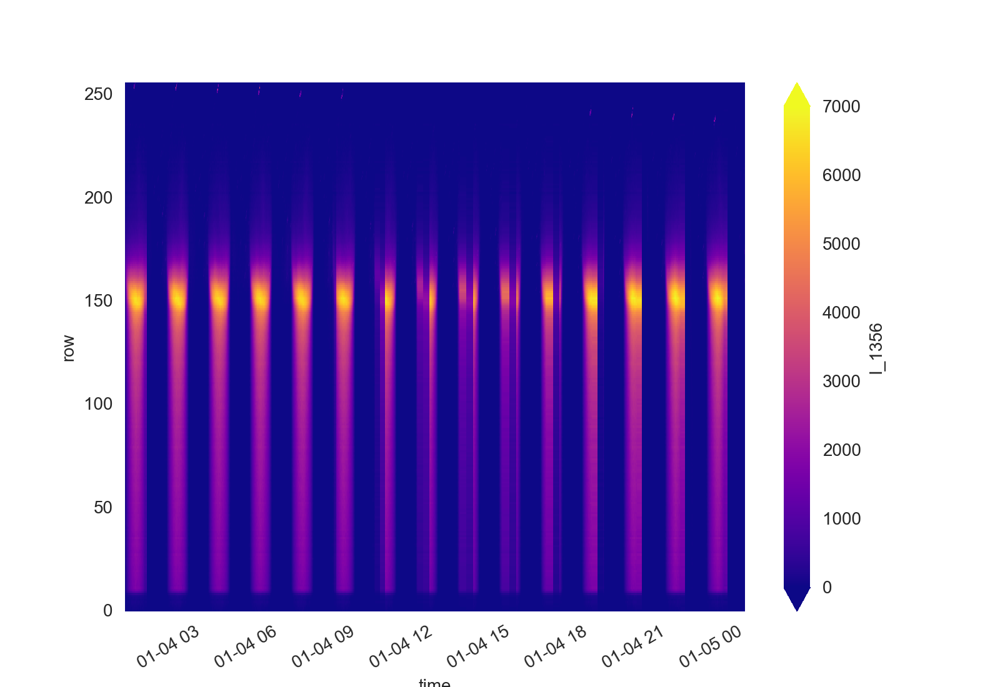

In [79]:
plt.figure()
plt.title('Jan 4 2020')
df_04.I_1356.T.plot(vmin=0, vmax=7000, cmap='plasma')
plt.show()
plt.savefig('Jan4_all.png')

<IPython.core.display.Javascript object>


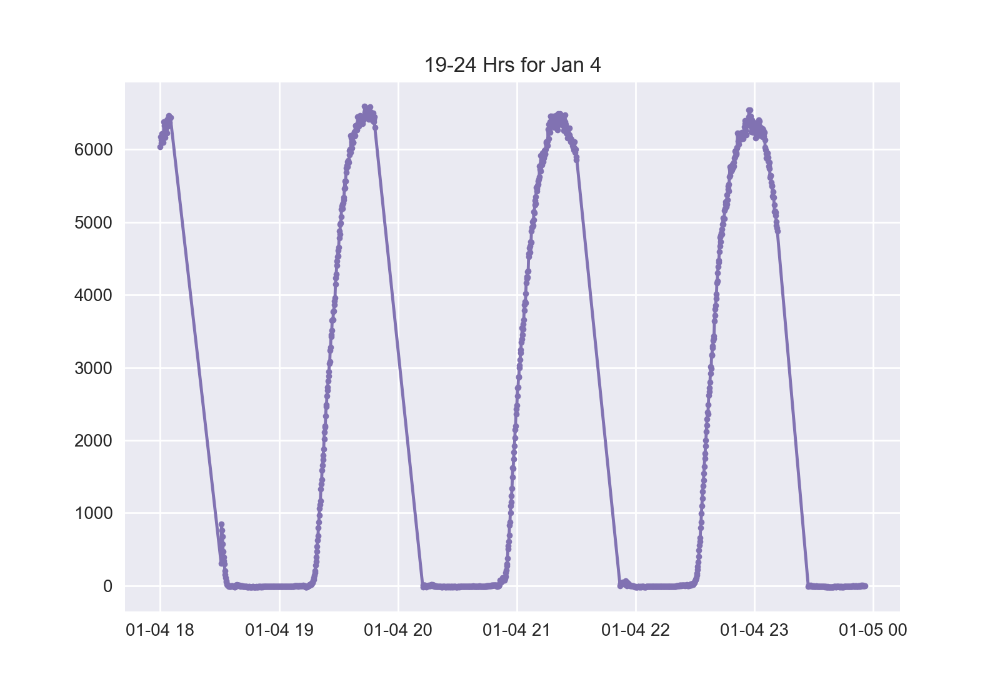

In [80]:
df_04_range = df_04.isel(row = 148).isel(time = slice(4500,5812))
plt.figure()
plt.title('19-24 Hrs for Jan 4')
plt.plot(df_04_range.time, df_04_range.I_1356, 'C3.-') # 10x factor is just for convenience- removed for now
plt.show()
plt.savefig('Jan4_1924_unfilled.png')

<IPython.core.display.Javascript object>


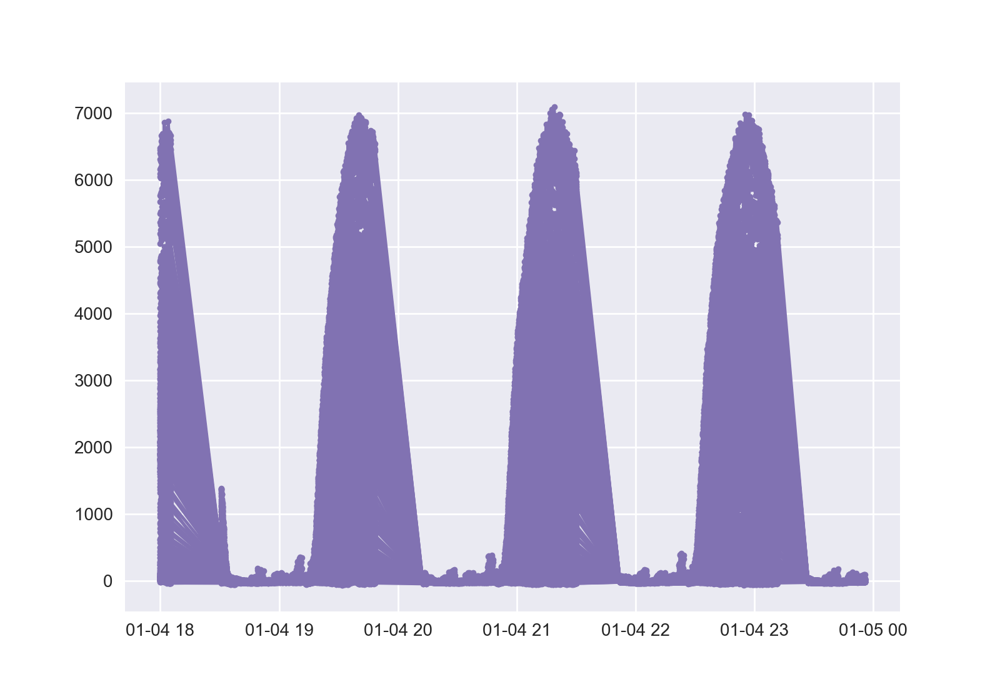

In [13]:
df_04_range = df_04.isel(time = slice(4500,5812))
plt.figure()
plt.plot(df_04_range.time, df_04_range.I_1356, 'C3.-') # 10x factor is just for convenience- removed for now
plt.show()
plt.savefig('Jan4_1924_filled.png')

<IPython.core.display.Javascript object>


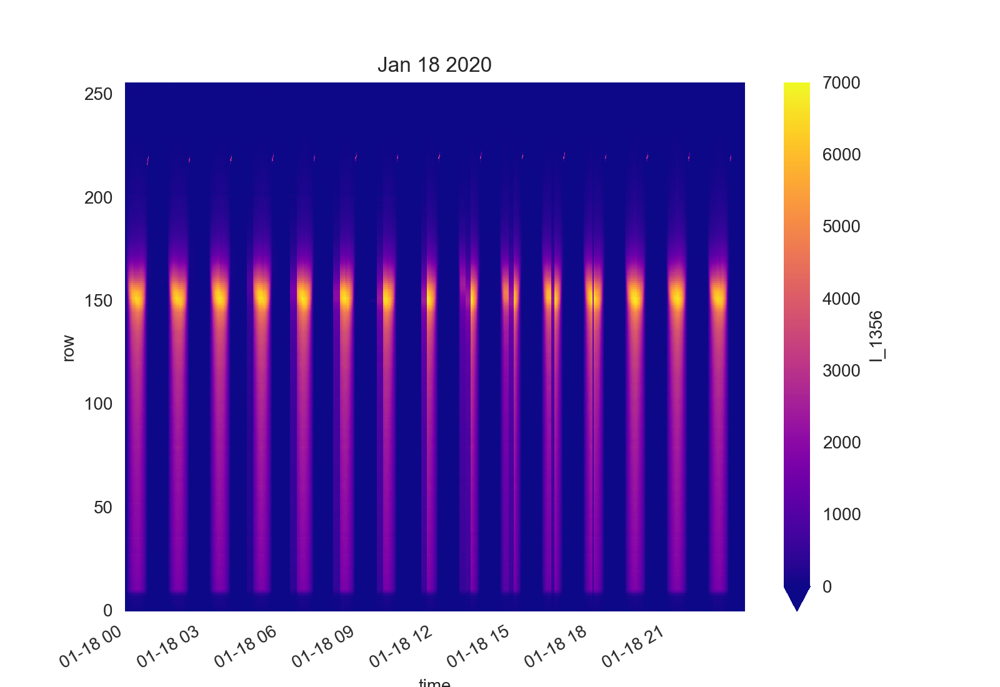

In [7]:
# Dark Spot- Checking to see if its actually there- random day selected.

plt.figure()
df_18.I_1356.T.plot(vmin=0, vmax=7000, cmap='plasma')
plt.title('Jan 18 2020')
plt.show()
plt.savefig('Jan18_all.png')

# Doesn't seem to have the band

In [23]:
# Picking days about 1 cycle apart

L1f_fn_217 = 'ICON_L1_FUV_SWP_2020-02-17_v05r000.NC'
L1f_fn_218 = 'ICON_L1_FUV_SWP_2020-02-18_v05r000.NC'
L1f_fn_219 = 'ICON_L1_FUV_SWP_2020-02-19_v05r000.NC'

df_217 = data_opening(L1f_fn_217)
df_218 = data_opening(L1f_fn_218)
df_219 = data_opening(L1f_fn_219)

<IPython.core.display.Javascript object>


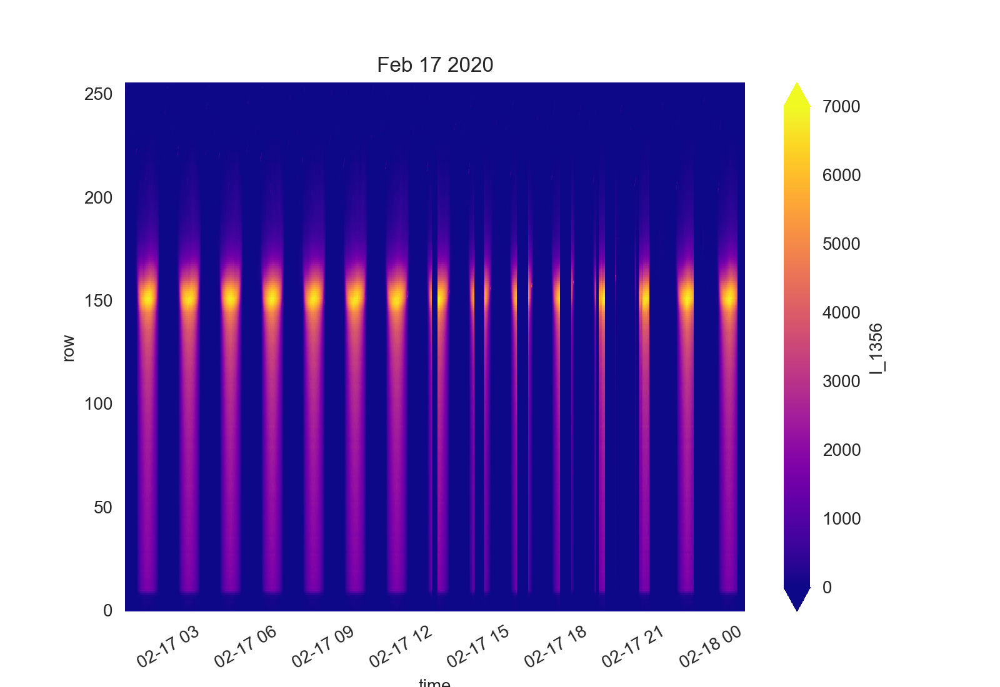

<IPython.core.display.Javascript object>


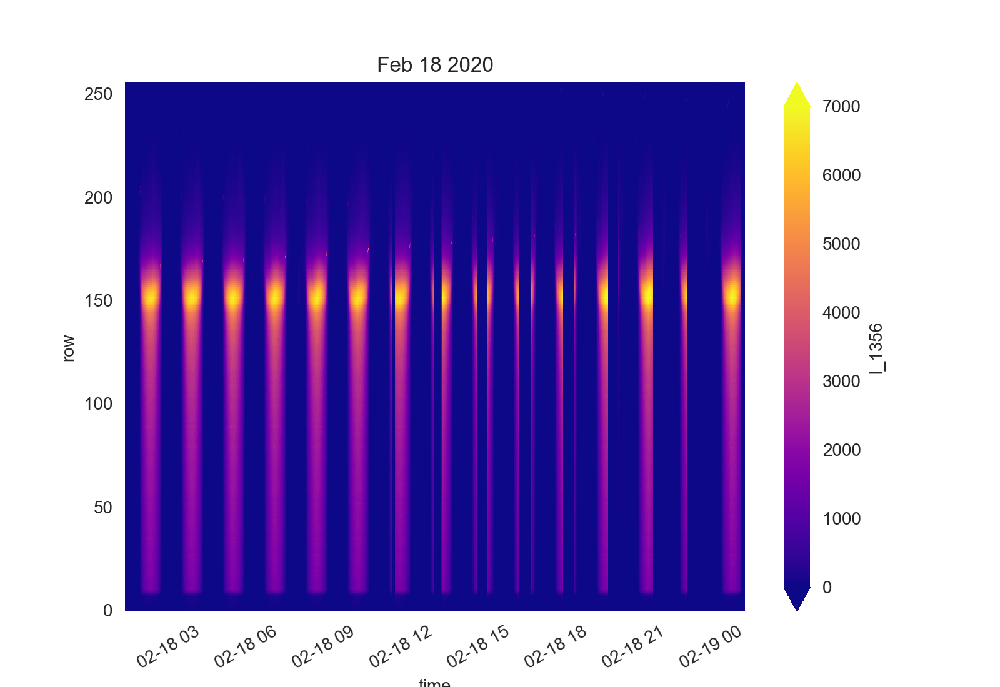

<IPython.core.display.Javascript object>


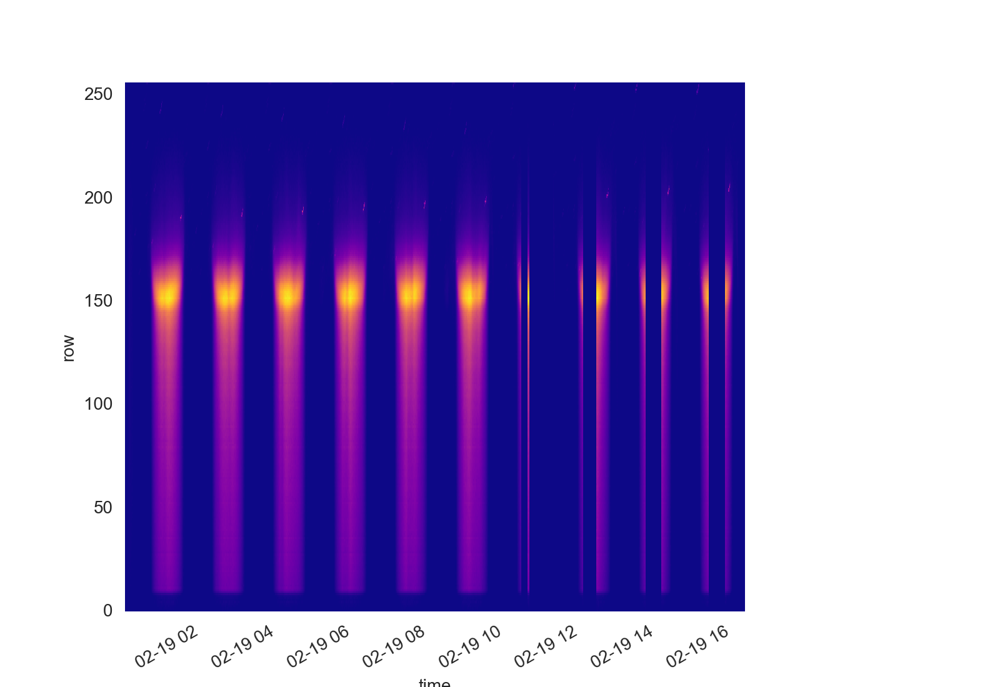

In [11]:
plt.figure()
df_217.I_1356.T.plot(vmin=0, vmax=7000, cmap='plasma')
plt.title('Feb 17 2020')
plt.show()
plt.savefig('Feb17_all.png')

plt.figure()
df_218.I_1356.T.plot(vmin=0, vmax=7000, cmap='plasma')
plt.title('Feb 18 2020')
plt.show()
plt.savefig('Feb18_all.png')

plt.figure()
df_219.I_1356.T.plot(vmin=0, vmax=7000, cmap='plasma')
plt.title('Feb 19 2020')
plt.show()
plt.savefig('Feb19_all.png')

## PEAK FINDING

<IPython.core.display.Javascript object>


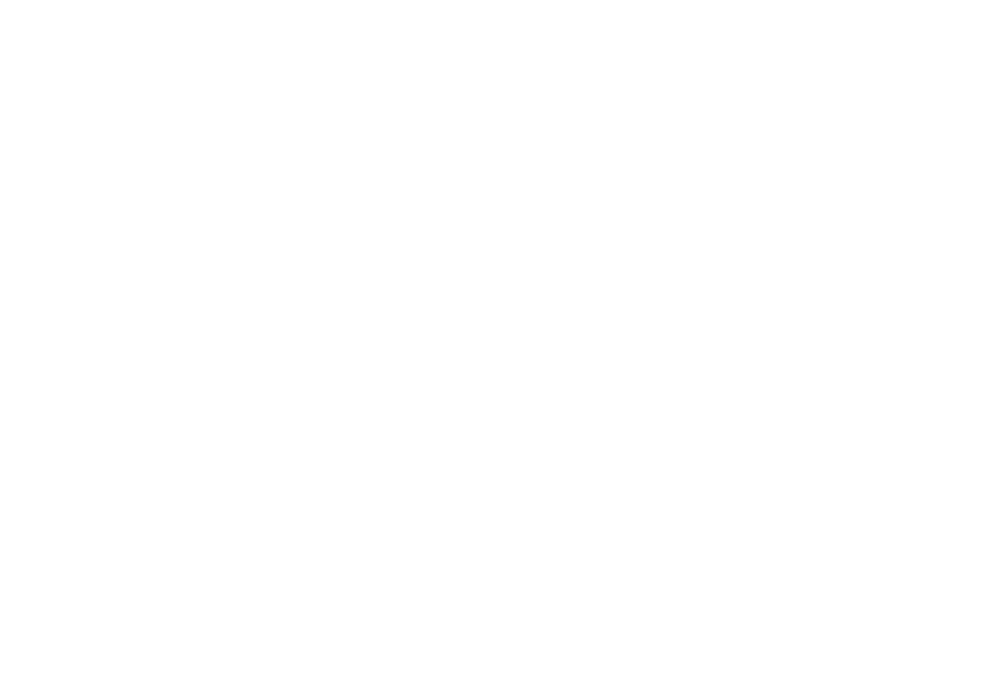

In [9]:
df_04_plt = df_04.isel(row = 148)
plt.figure()
plt.title('Jan 4')
plt.plot(df_04_plt.time, df_04_plt.I_1356, 'C3.-') 
plt.show()


In [8]:
#PEAK FINDER
from scipy.signal import find_peaks
data = df_04.I_1356.isel(row = 148)
data.to_numpy()
np.shape(data)

(5832,)

In [9]:
indices = find_peaks(data, width = 25, height = 4000) # add 'width' as the orbit separation 
len(indices[0])

15

In [12]:
indexes = indices[0]

In [13]:
times_np = df_04_plt.time.to_numpy()

In [14]:
times = []
vals_at_times = []
for i in indexes: 
    times.append(times_np[i])
    vals_at_times.append(data[i])
    

<IPython.core.display.Javascript object>


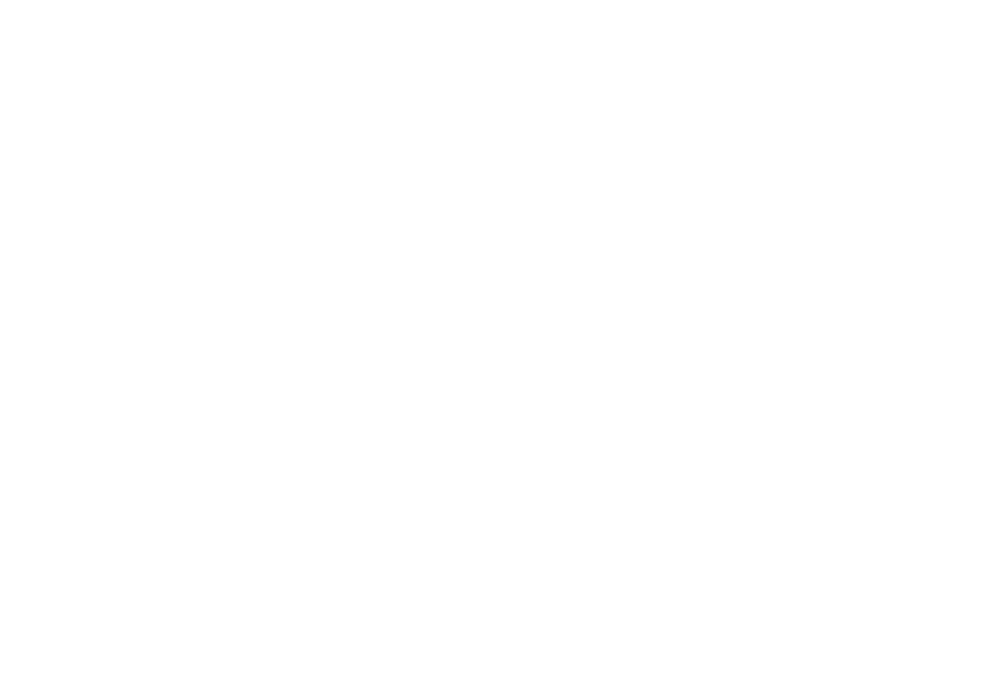

In [15]:
df_04_plt = df_04.isel(row = 148)
plt.figure()
plt.title('Peaks for Jan 4')
plt.plot(df_04_plt.time, df_04_plt.I_1356, 'C3.-') 
plt.plot(times,vals_at_times,'r')
plt.show()


<IPython.core.display.Javascript object>


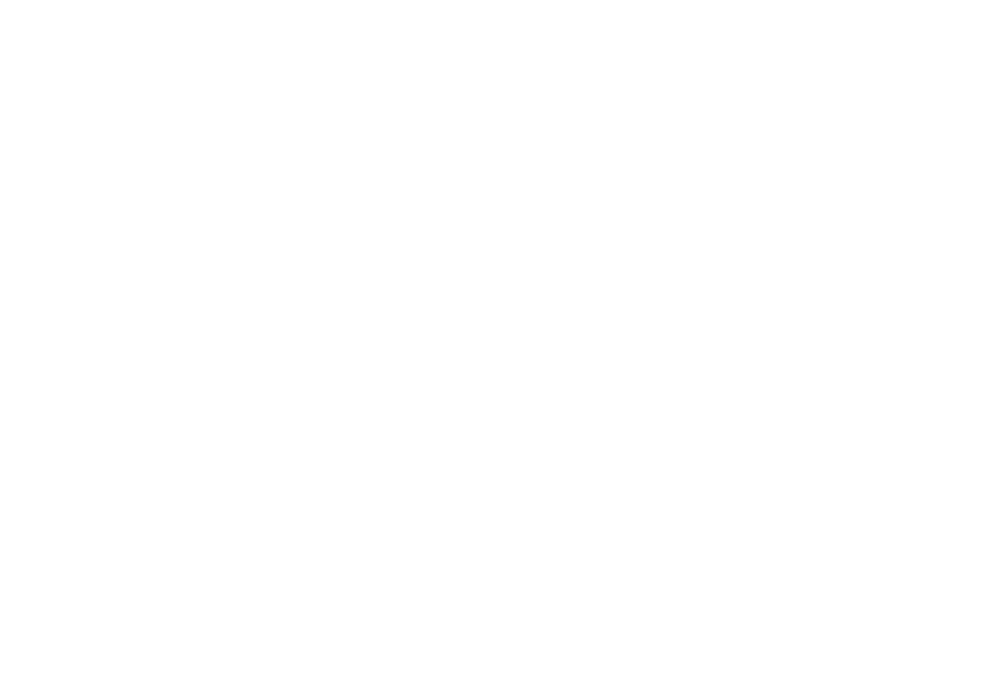

In [16]:
df_04_plt = df_04.isel(row = 148)
plt.figure()
plt.title('Peaks for Jan 4')
plt.plot(df_04_plt.time, df_04_plt.I_1356, 'C3.-') 

for i in range(0,len(times)):
    plt.plot(times[i],vals_at_times[i],'ro', markersize = 5)
    
plt.show()


<IPython.core.display.Javascript object>


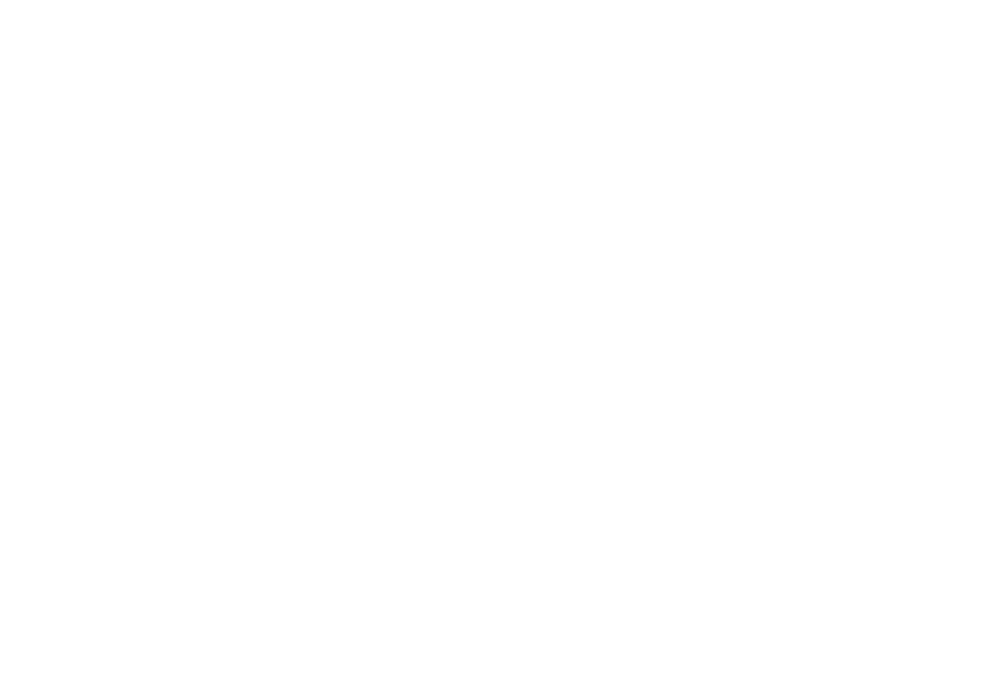

6716.1606
15


<IPython.core.display.Javascript object>


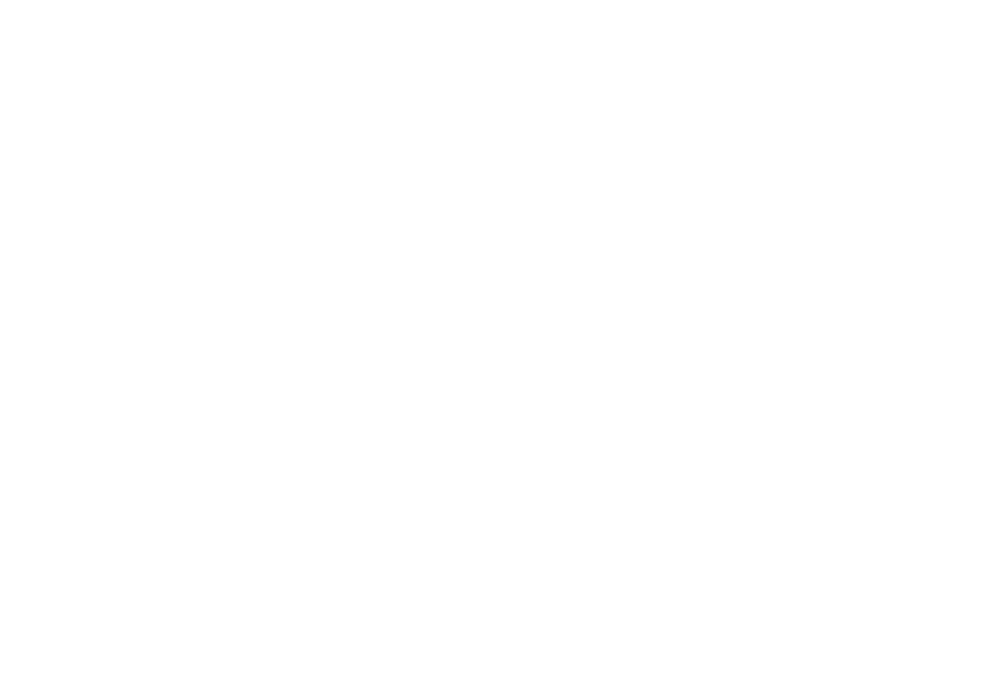

In [19]:
## TRYING WITH A DIFFERENT DAY
df_02_plt = df_02.isel(row = 148)
plt.figure()
plt.title('Jan 2')
plt.plot(df_02_plt.time, df_02_plt.I_1356, 'C3.-') 
plt.show()

from scipy.signal import find_peaks
data = df_02.I_1356.isel(row = 148)
data_np = data.to_numpy()
np.shape(data)

print(max(data_np))


indices = find_peaks(data, width = 25, height = 4000) # add 'width' as the orbit separation 
print(len(indices[0]))
indexes = indices[0]

times_np = df_02_plt.time.to_numpy()

times = []
vals_at_times = []
for i in indexes: 
    times.append(times_np[i])
    vals_at_times.append(data[i])

df_02_plt = df_02.isel(row = 148)
plt.figure()
plt.title('Peaks for Jan 2')
plt.plot(df_02_plt.time, df_02_plt.I_1356, 'C3.-') 

for i in range(0,len(times)):
    plt.plot(times[i],vals_at_times[i],'ro', markersize = 5)
    
plt.show()



In [ ]:
vals_at_times

In [12]:
#FUNCTION

def wave_peaks(df,r):
    df_plt = df.isel(row = r)
    plt.figure()
    plt.title('Data')
    plt.plot(df_plt.time, df_plt.I_1356, 'C3.-') 
    plt.show()
    
    from scipy.signal import find_peaks
    data = df.I_1356.isel(row = r)
    data_np = data.to_numpy()
    np.shape(data)
    
    max_data = max(data_np)
    
    indices = find_peaks(data, width = 25, height = max_data * (4/6))  
    
    #print(len(indices[0]))
    indexes = indices[0]
    
    times_np = df_plt.time.to_numpy()
    
    times = []
    vals_at_times = []
    for i in indexes: 
        times.append(times_np[i])
        vals_at_times.append(data[i])
        
    df_plt = df.isel(row = r)
    plt.figure()
    plt.title('Peaks')
    plt.plot(df_plt.time, df_plt.I_1356, 'C3.-') 

    for i in range(0,len(times)):
        plt.plot(times[i],vals_at_times[i],'ro', markersize = 5)
    plt.show()

    

<IPython.core.display.Javascript object>


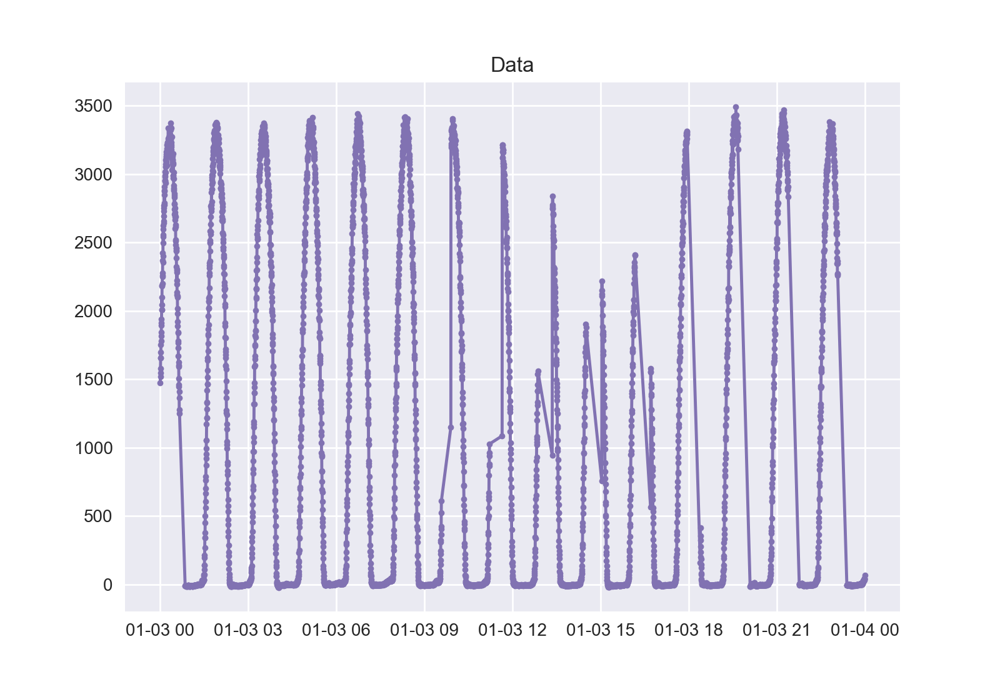

<IPython.core.display.Javascript object>


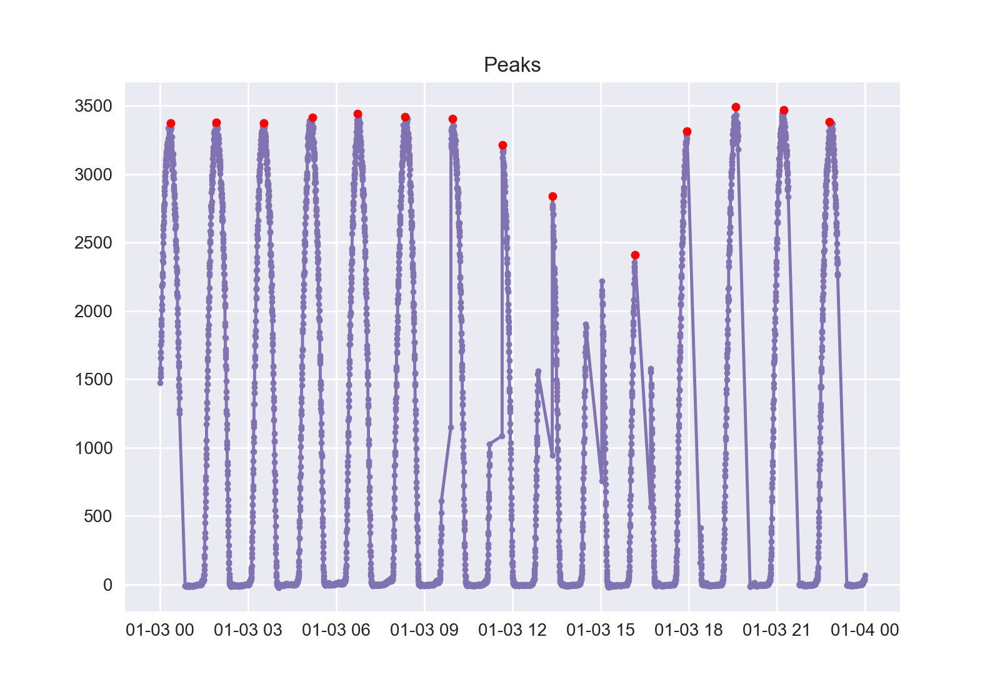

In [13]:
wave_peaks(df_03,120)

<IPython.core.display.Javascript object>


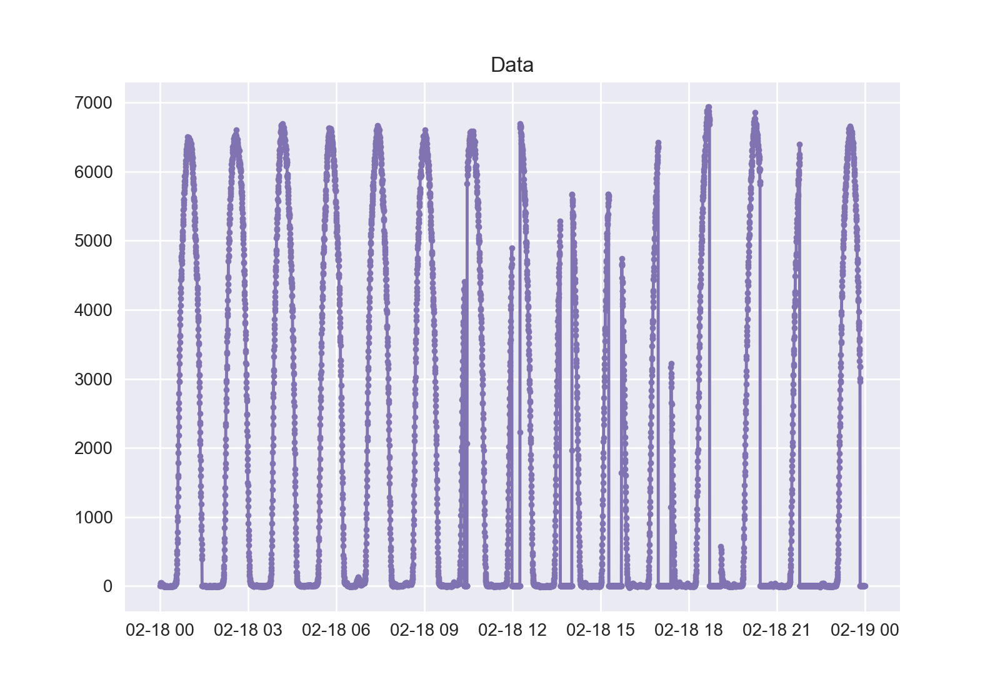

<IPython.core.display.Javascript object>


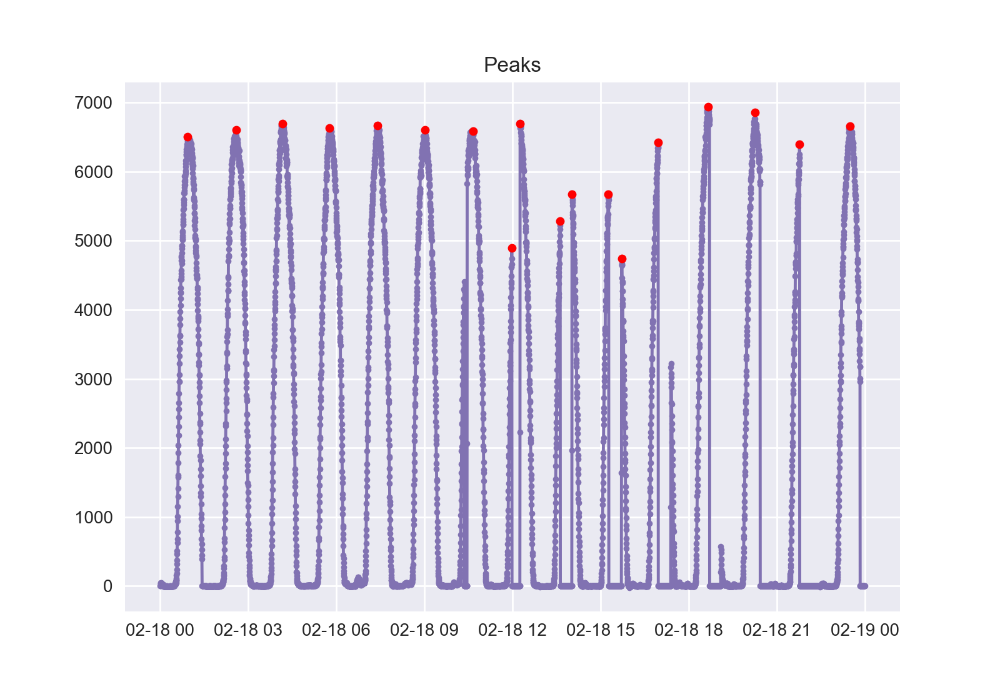

In [45]:
wave_peaks(df_218,149)
#zoom in to around 12

In [14]:
# Trying Different Days on Different Seasons around the year: SPR
L1f_fn_322 = 'ICON_L1_FUV_SWP_2020-03-22_v05r000.NC'
L1f_fn_419 = 'ICON_L1_FUV_SWP_2020-04-19_v05r000.NC'
L1f_fn_510 = 'ICON_L1_FUV_SWP_2020-05-10_v05r000.NC'

df_322 = data_opening(L1f_fn_322)
df_419 = data_opening(L1f_fn_419)
df_510 = data_opening(L1f_fn_510)

<IPython.core.display.Javascript object>


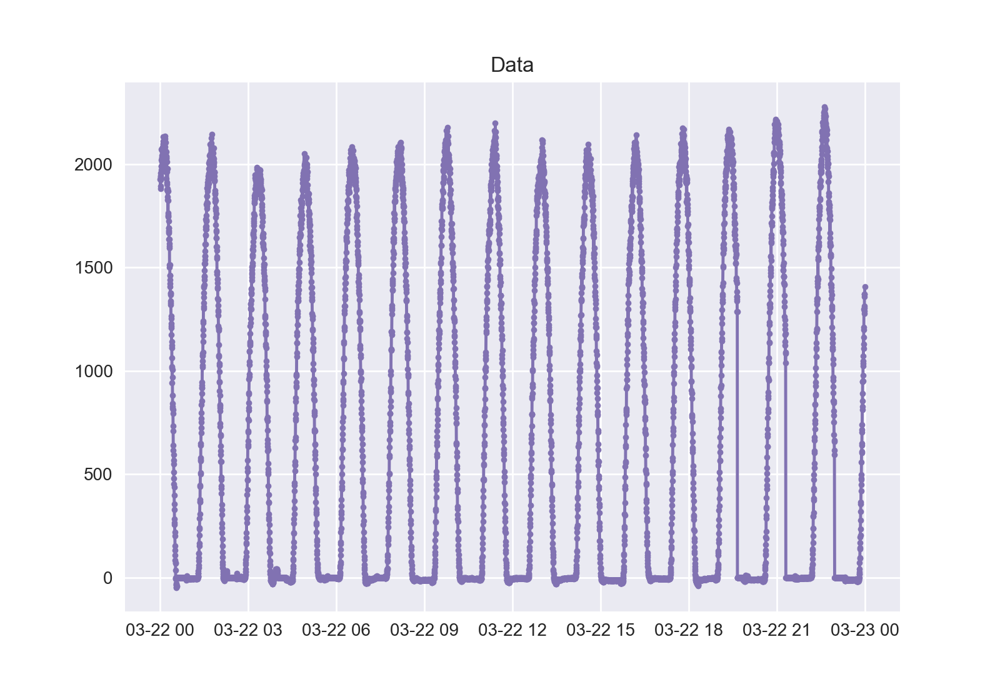

<IPython.core.display.Javascript object>


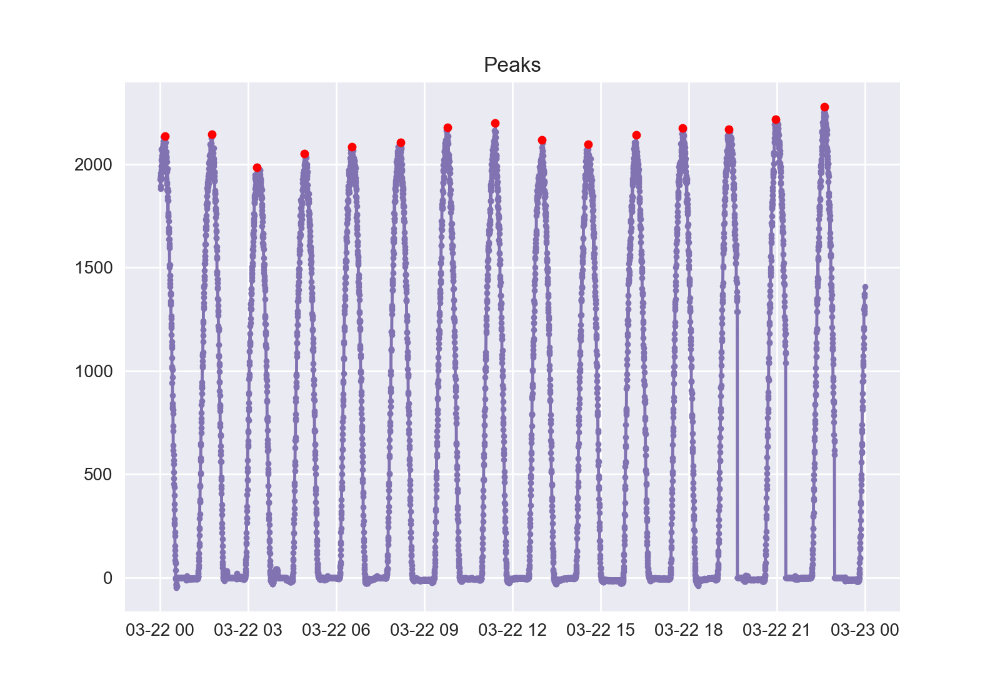

In [15]:
wave_peaks(df_322, 30)

<IPython.core.display.Javascript object>


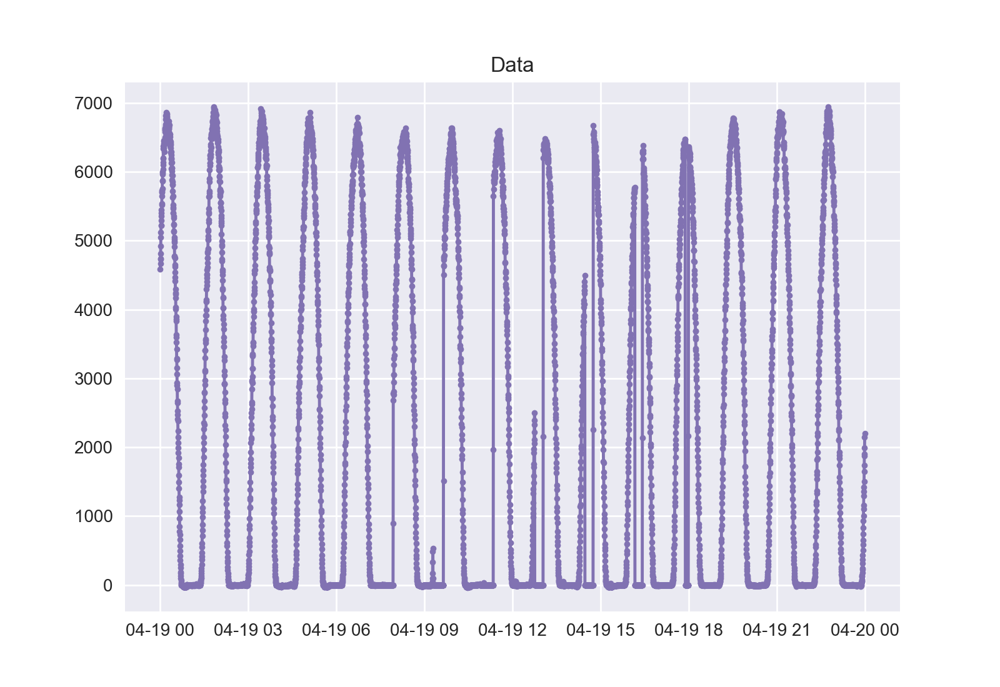

<IPython.core.display.Javascript object>


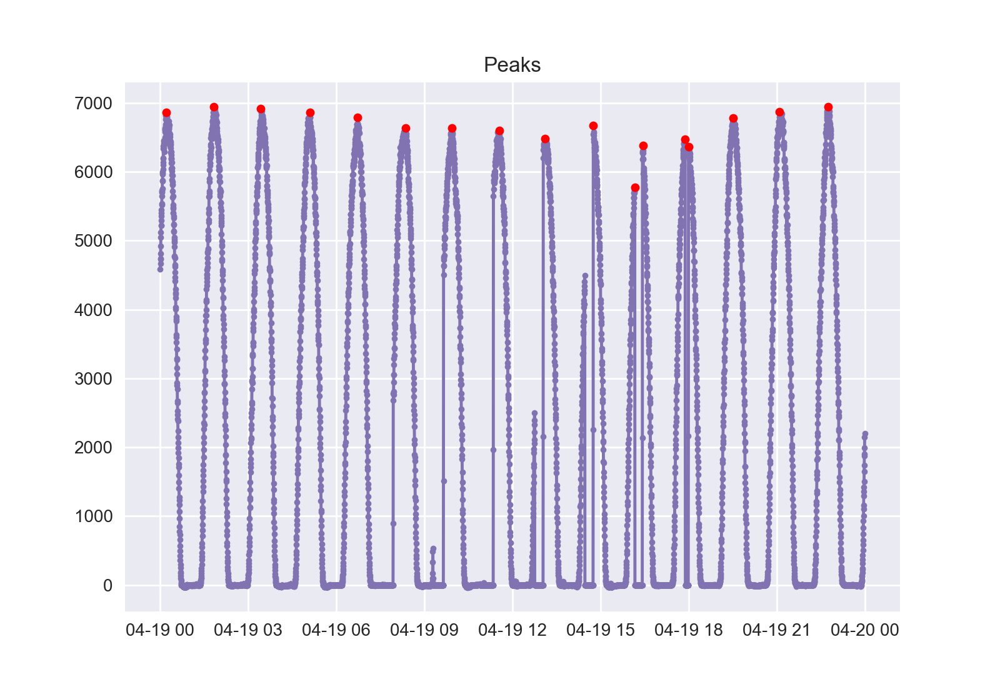

In [49]:
wave_peaks(df_419,148,50)

<IPython.core.display.Javascript object>


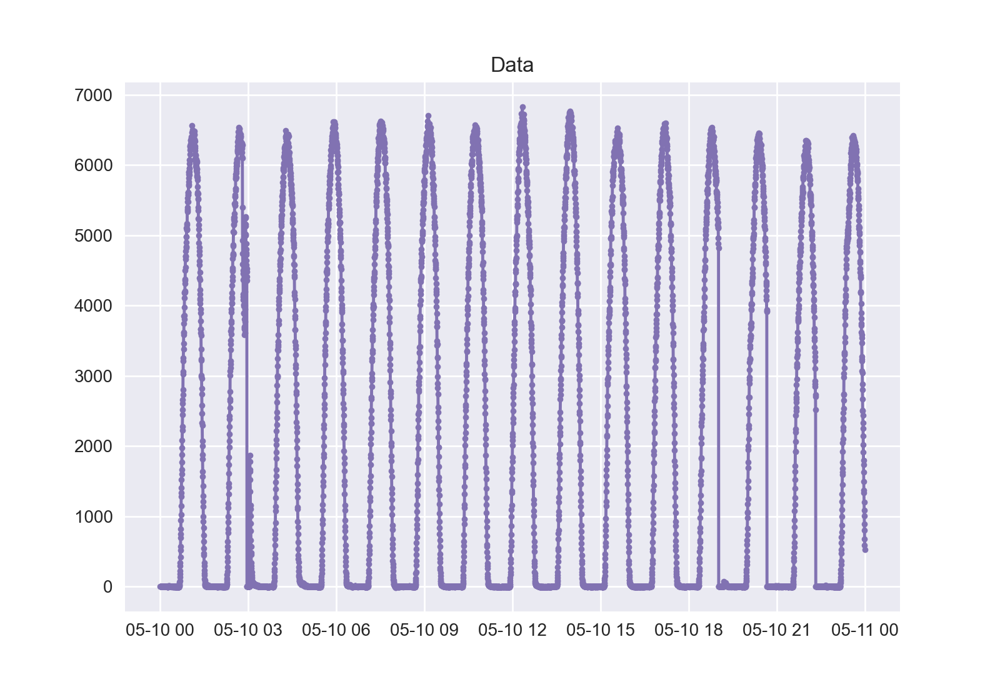

<IPython.core.display.Javascript object>


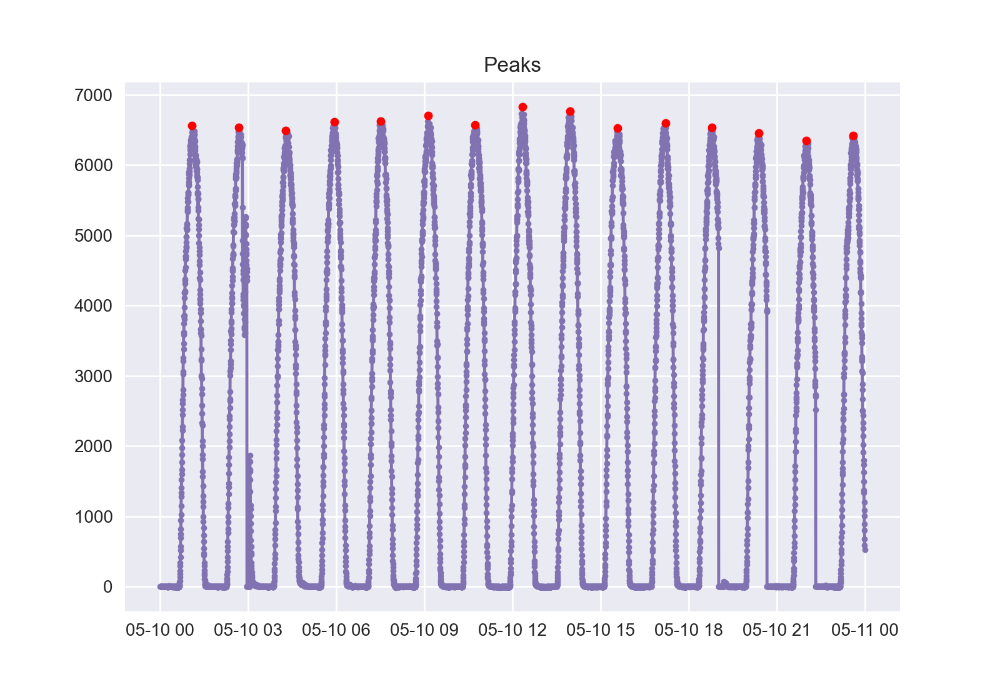

In [42]:
wave_peaks(df_510)

In [19]:
def wave_peaks_tdf(df,r):
    df_plt = df.isel(row = r)
    plt.figure()
    plt.title('Data')
    plt.plot(df_plt.time, df_plt.I_1356, 'C3.-') 
    plt.show()
    
    from scipy.signal import find_peaks
    data = df.I_1356.isel(row = r)
    data_np = data.to_numpy()
    np.shape(data)
    
    max_data = max(data_np)
    time_diff = datetime.timedelta(minutes=19, hours=1) 

    
    indices = find_peaks(data, height = max_data * (4/6), distance = 100) 
    
    indexes = indices[0]
    #print(indexes)
    final_indexes = []
    
    for i in range(0,len(indexes)-1):
        if len(indexes) > 15:
            if indexes[i+1] - indexes[i] < 200:
                pass
            else:
                final_indexes.append(indexes[i])
        else:
            final_indexes.append(indexes[i])
    final_indexes.append(indexes[-1])
    #print(final_indexes)
    
    times_np = df_plt.time.to_numpy()
    
    times = []
    vals_at_times = []
    for i in final_indexes: 
        times.append(times_np[i])
        vals_at_times.append(data[i])
    #print(times,vals_at_times)
        
    df_plt = df.isel(row = r)
    plt.figure()
    plt.title('Peaks')
    plt.plot(df_plt.time, df_plt.I_1356, 'C3.-') 

    for i in range(0,len(times)):
        plt.plot(times[i],vals_at_times[i],'ro', markersize = 5)
    plt.show()

    

<IPython.core.display.Javascript object>


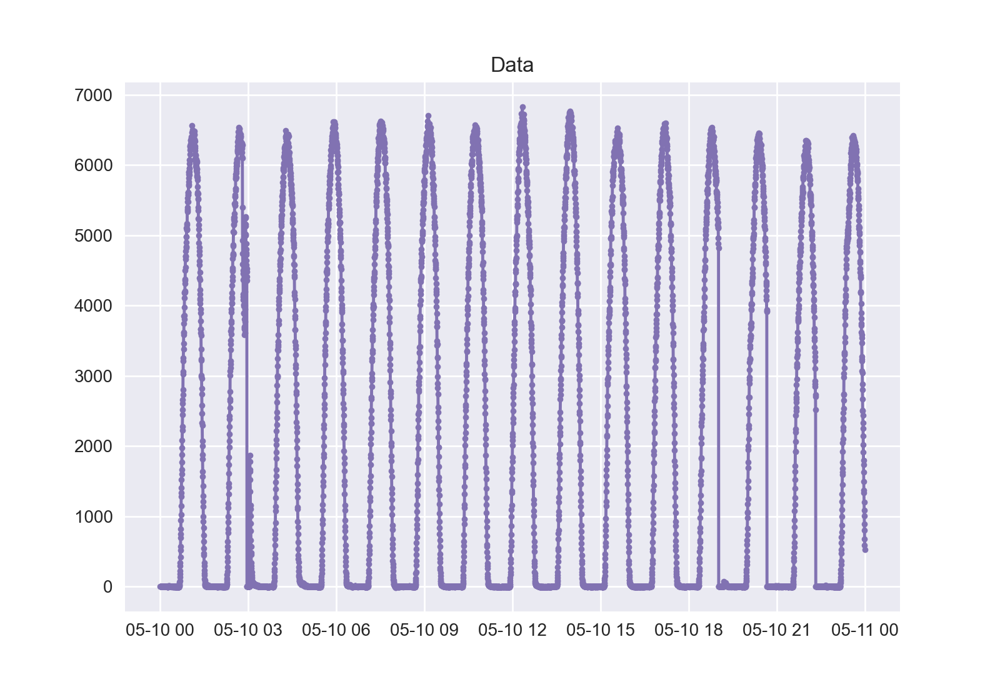

<IPython.core.display.Javascript object>


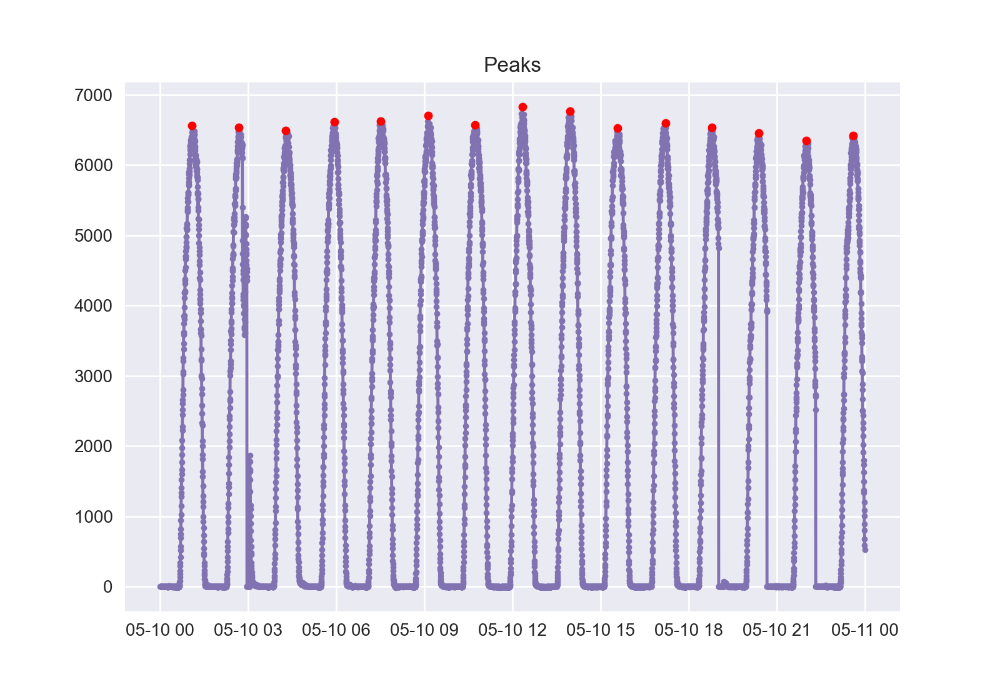

In [20]:
wave_peaks_tdf(df_510,148)

<IPython.core.display.Javascript object>


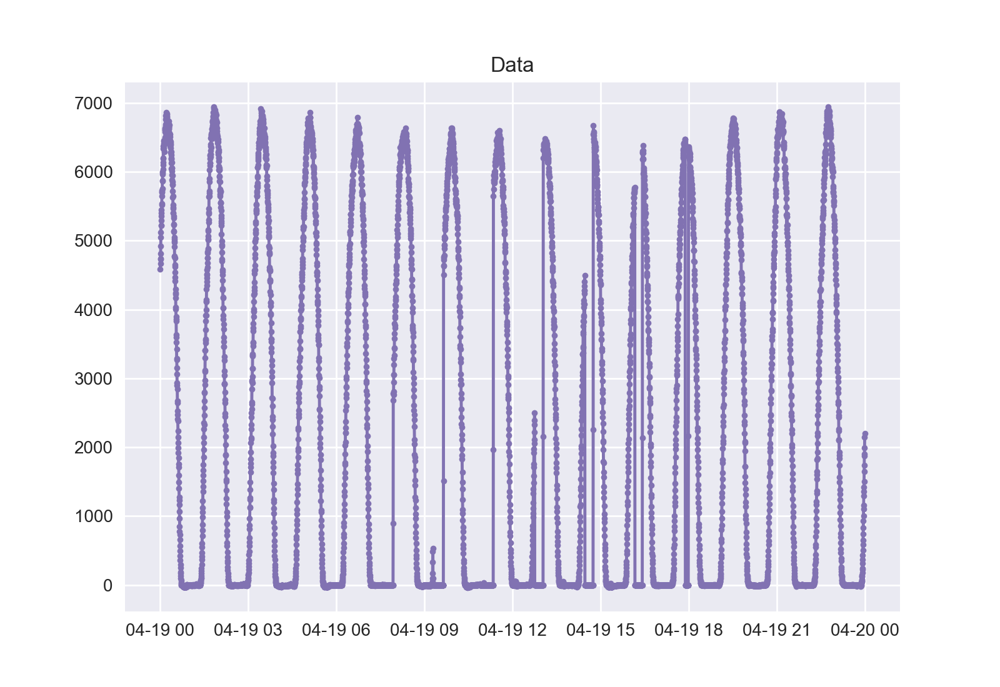

<IPython.core.display.Javascript object>


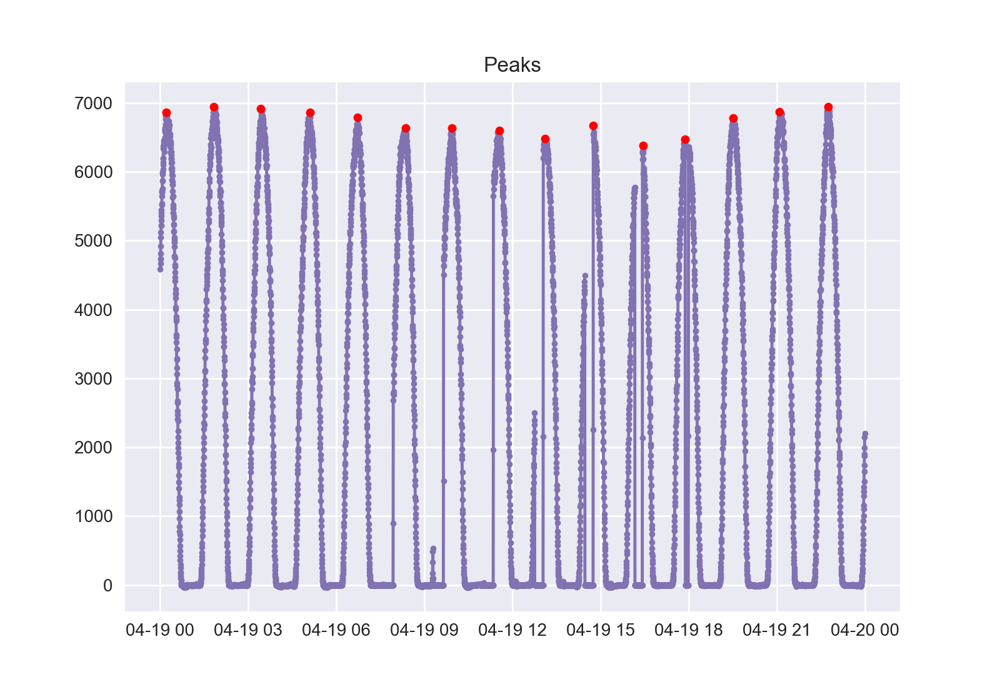

In [21]:
wave_peaks_tdf(df_419,148)

In [ ]:
[ 317  779 1246 1730 2192 2666 3129 3603 4077 4549 5032 5490 5956 6430
 6892]

In [90]:
1730-1246

484

In [91]:
2666- 2192

474

#### BACK TO SEASONS

In [10]:
# SPRING
df_322 = data_opening(L1f_fn_322)
df_419 = data_opening(L1f_fn_419)
df_510 = data_opening(L1f_fn_510)

NameError: name 'L1f_fn_322' is not defined

<IPython.core.display.Javascript object>


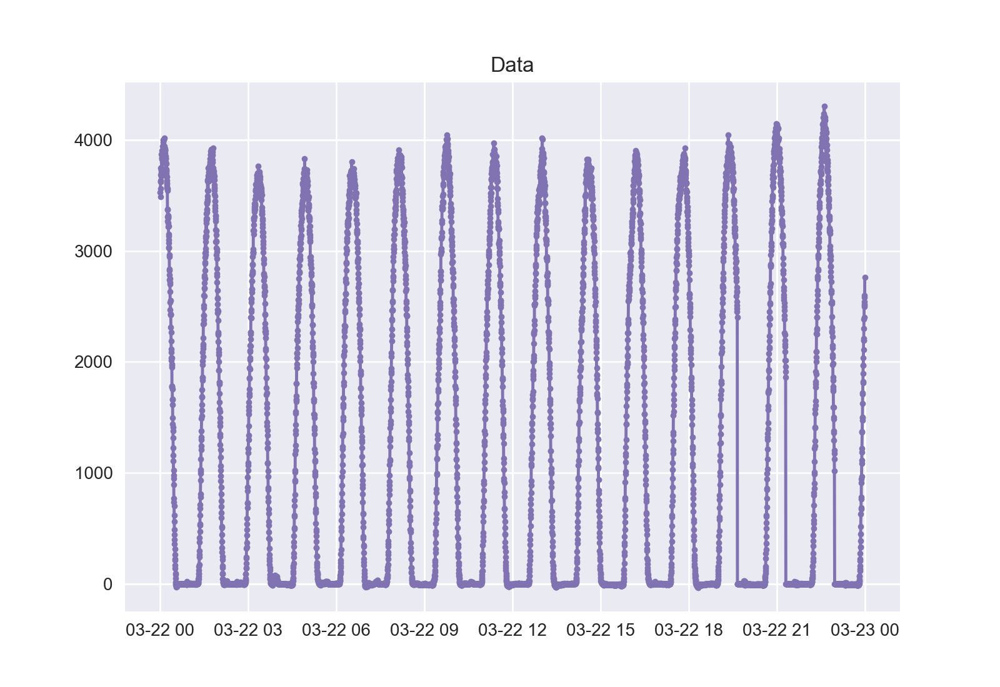

<IPython.core.display.Javascript object>


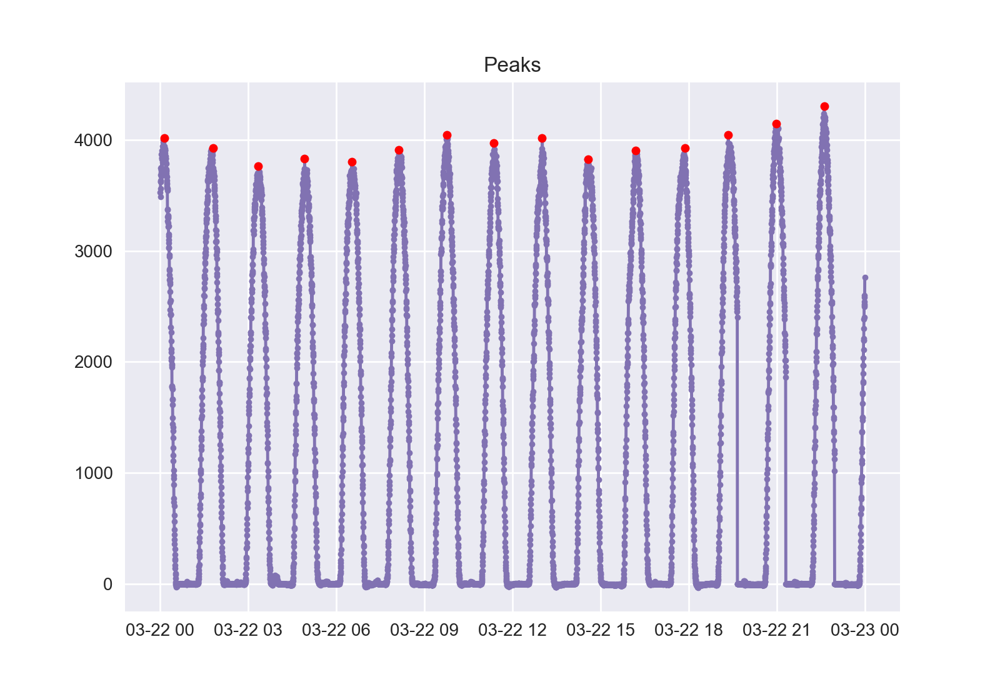

In [121]:
wave_peaks_tdf(df_322,130)

<IPython.core.display.Javascript object>


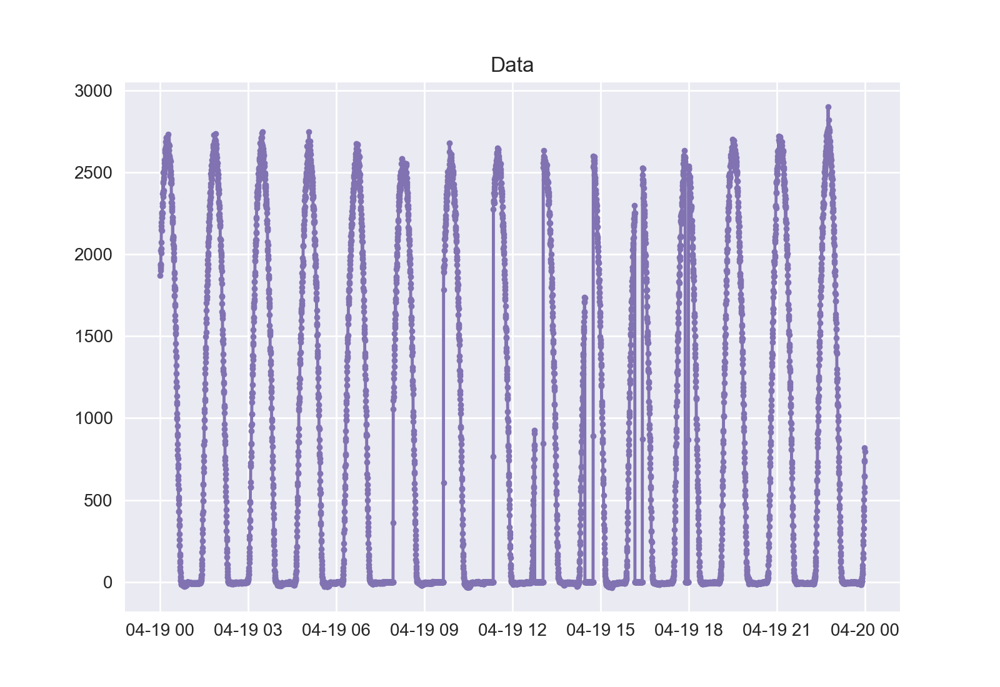

<IPython.core.display.Javascript object>


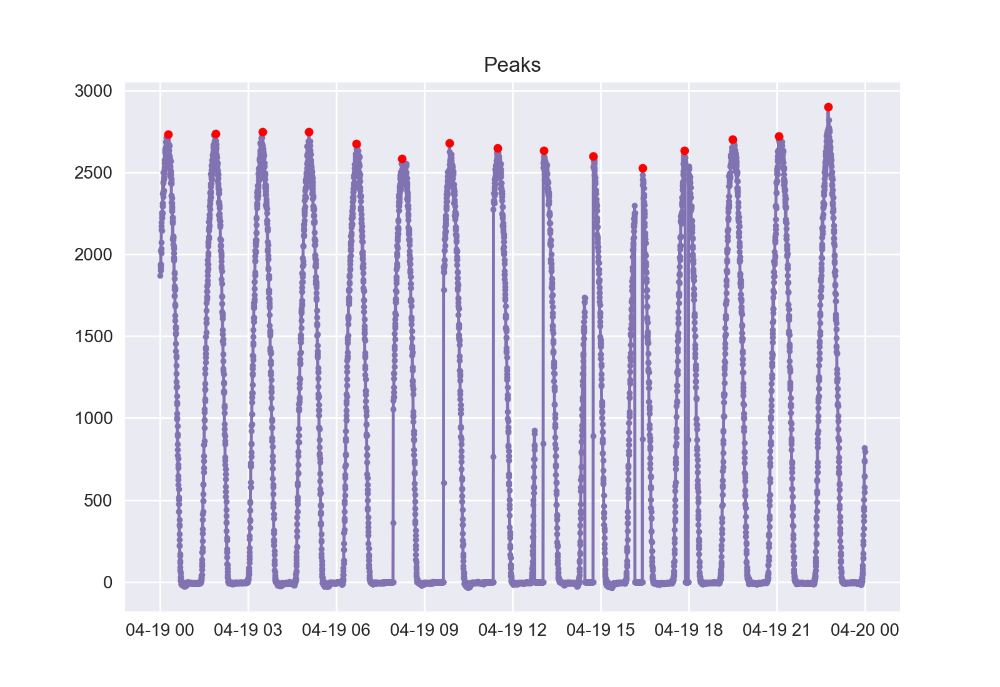

In [124]:
wave_peaks_tdf(df_419,95)

<IPython.core.display.Javascript object>


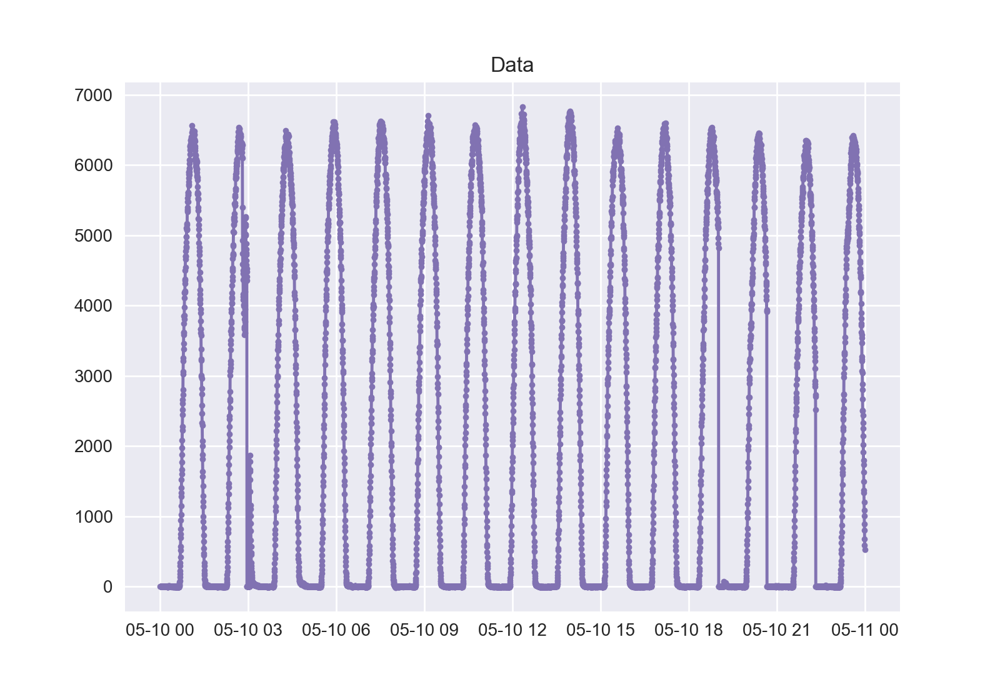

<IPython.core.display.Javascript object>


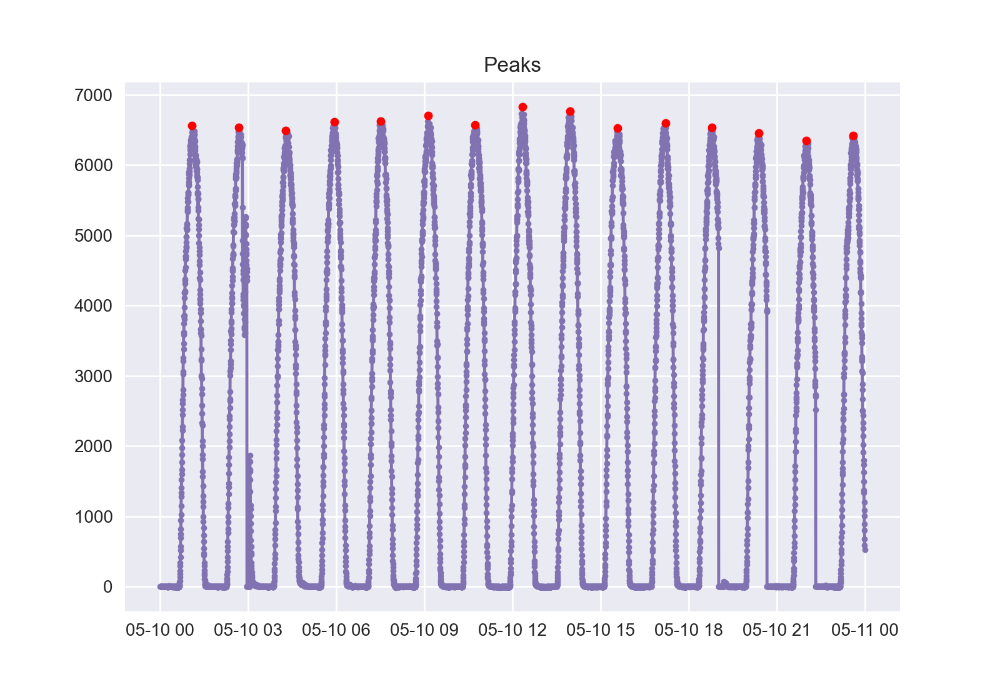

In [123]:
wave_peaks_tdf(df_510,148)

In [125]:
## SUMMER

L1f_fn_609 = 'ICON_L1_FUV_SWP_2020-06-09_v05r000.NC'
L1f_fn_719 = 'ICON_L1_FUV_SWP_2020-07-19_v05r000.NC'
L1f_fn_831 = 'ICON_L1_FUV_SWP_2020-08-31_v05r000.NC'


df_609 = data_opening(L1f_fn_609)
df_719 = data_opening(L1f_fn_719)
df_831 = data_opening(L1f_fn_831)

<IPython.core.display.Javascript object>


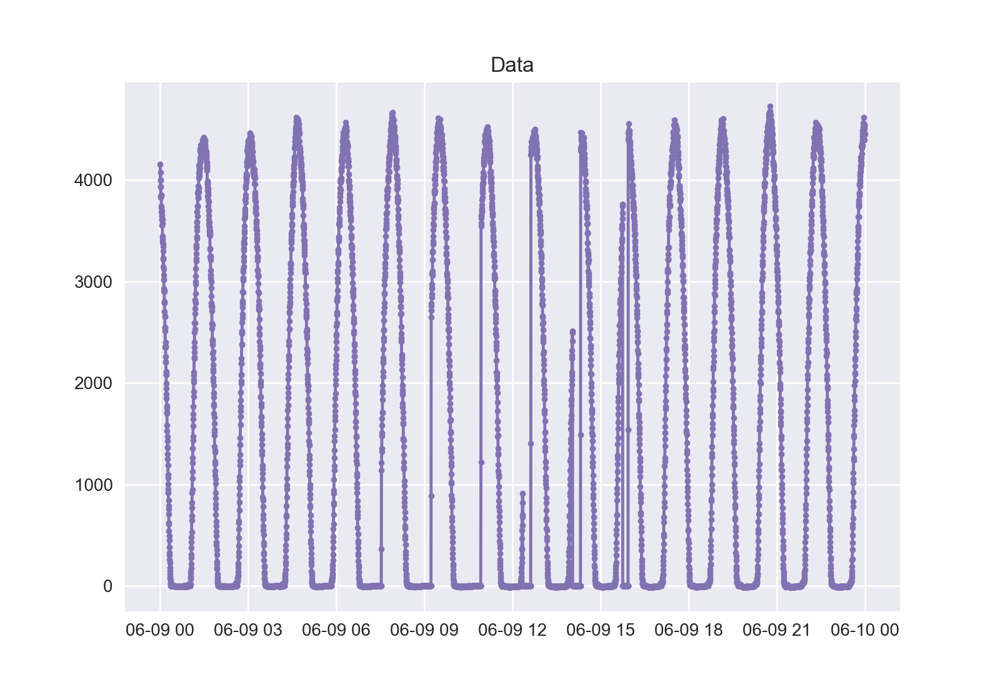

<IPython.core.display.Javascript object>


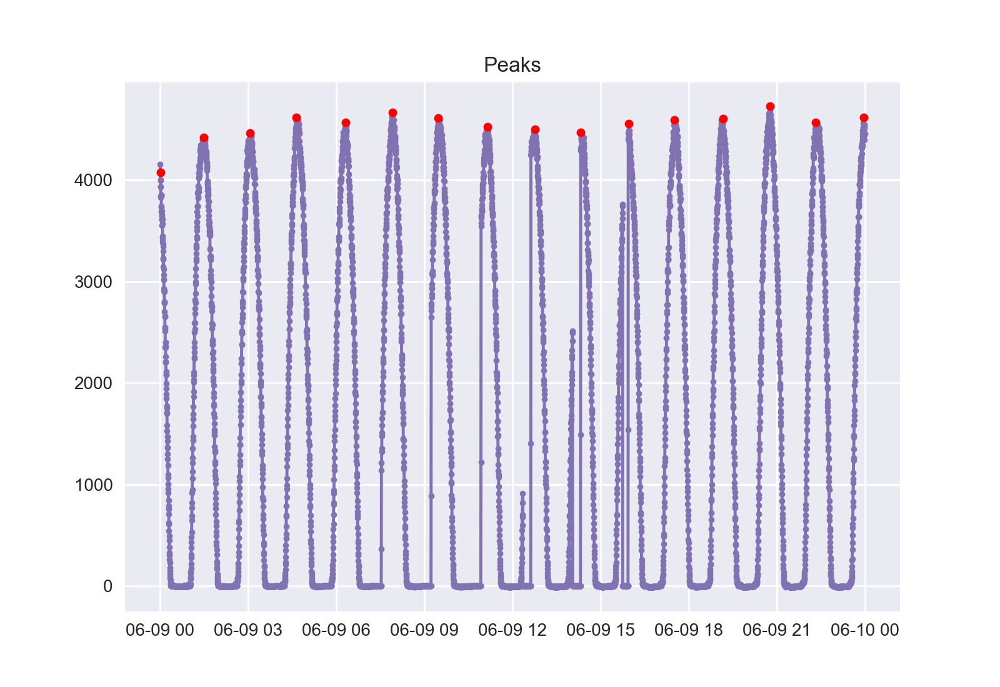

In [126]:
wave_peaks_tdf(df_609,120)

<IPython.core.display.Javascript object>


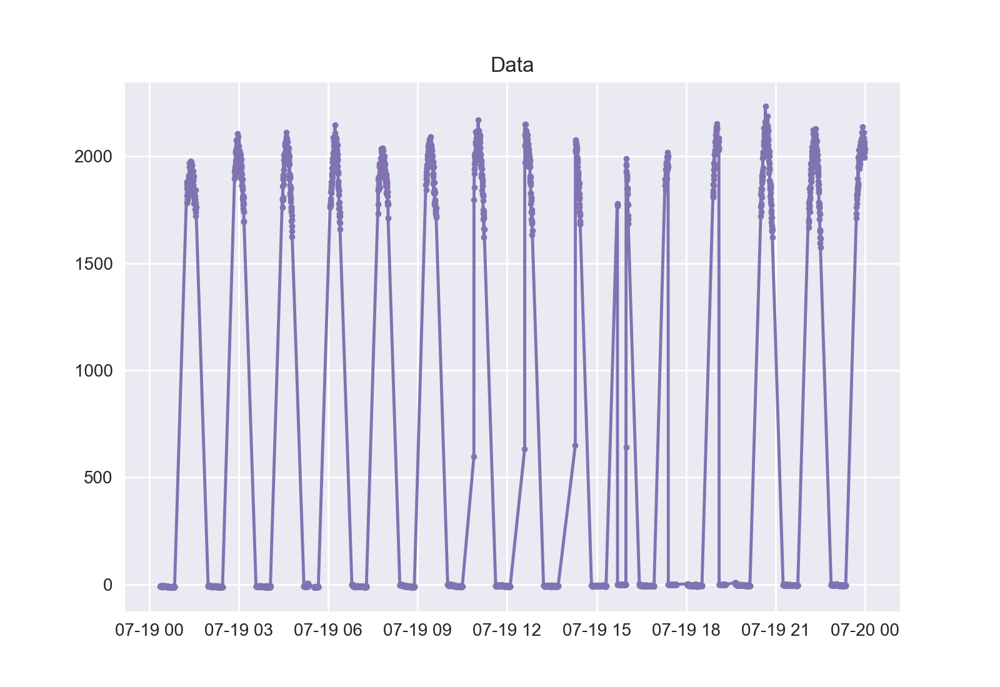

<IPython.core.display.Javascript object>


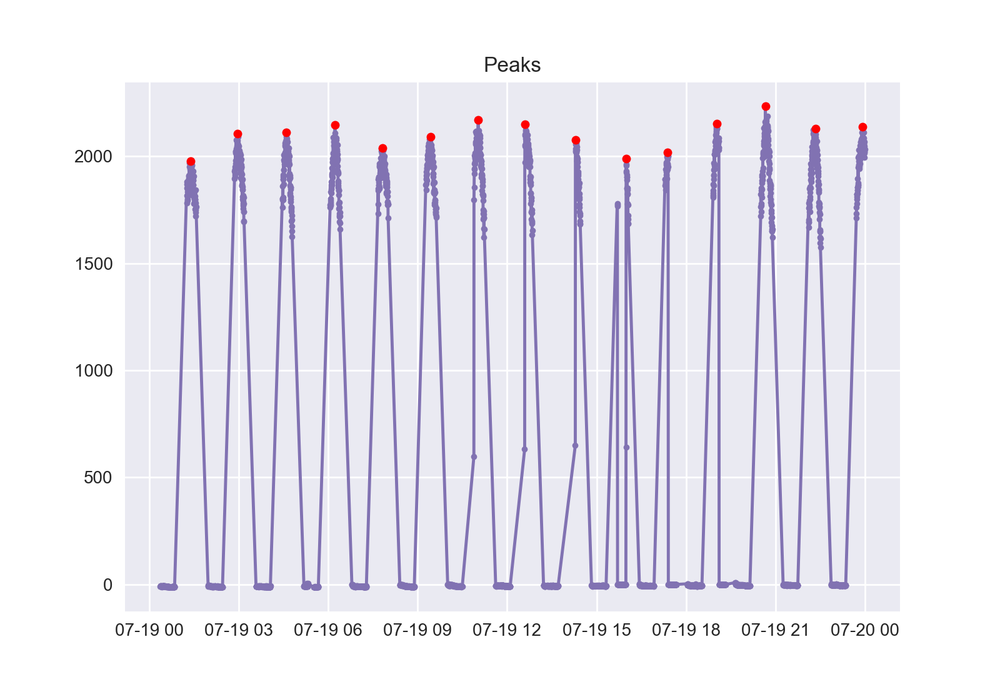

In [127]:
wave_peaks_tdf(df_719,75)

<IPython.core.display.Javascript object>


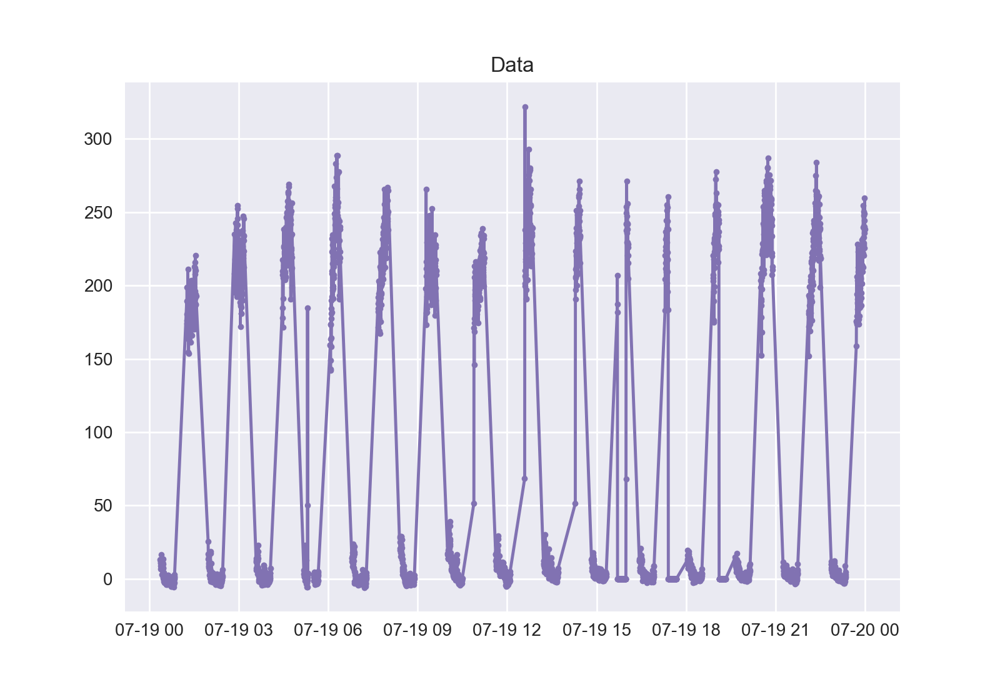

<IPython.core.display.Javascript object>


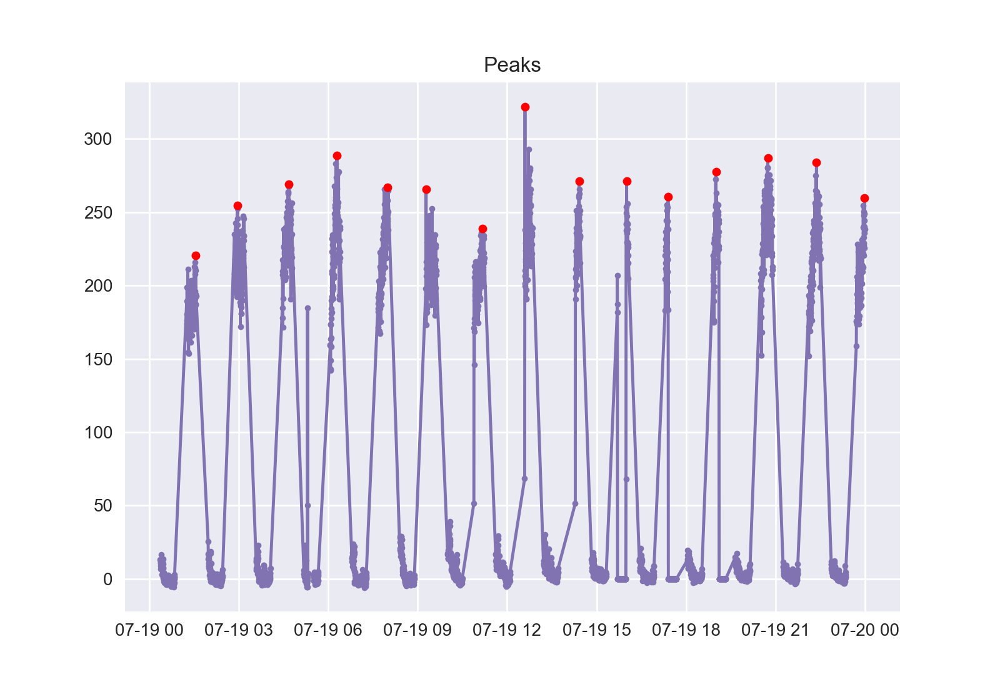

In [130]:
wave_peaks_tdf(df_719,175)

<IPython.core.display.Javascript object>


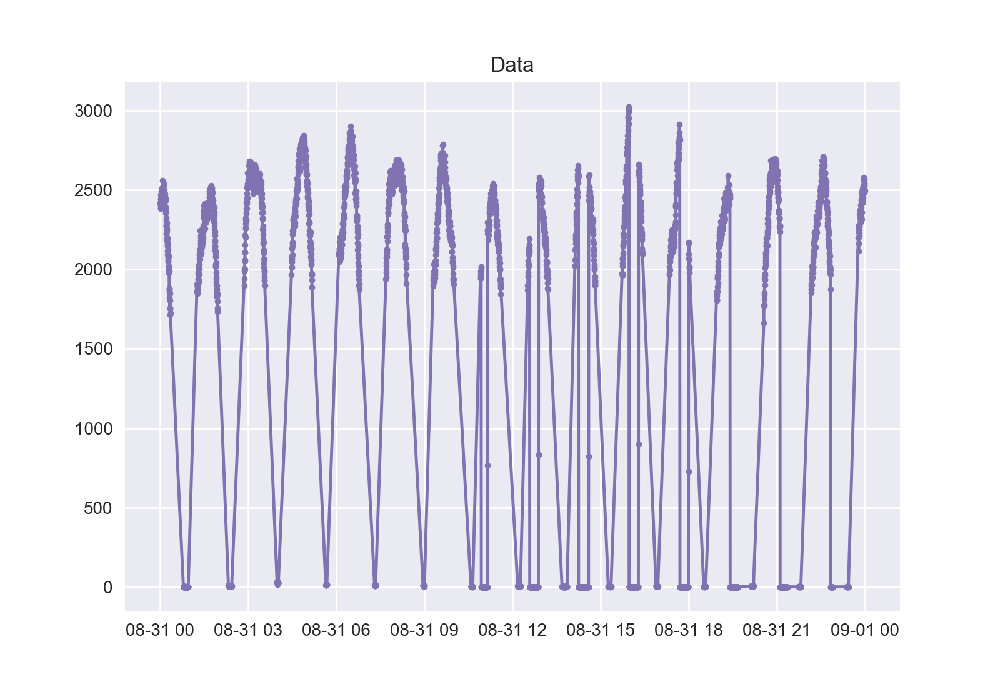

<IPython.core.display.Javascript object>


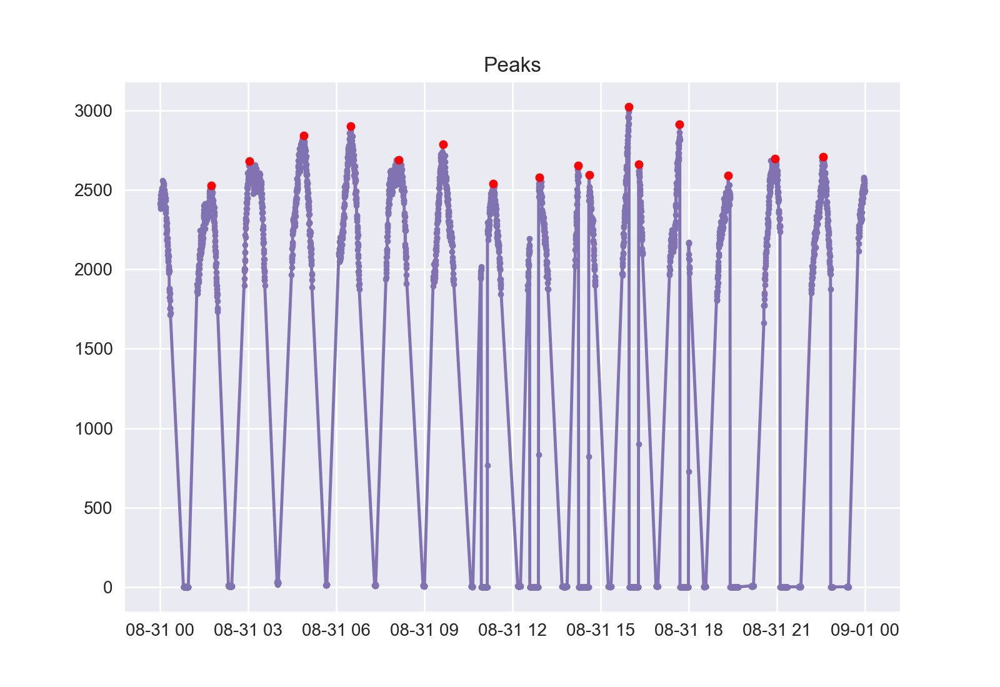

In [133]:
wave_peaks(df_831,148,25)

<IPython.core.display.Javascript object>


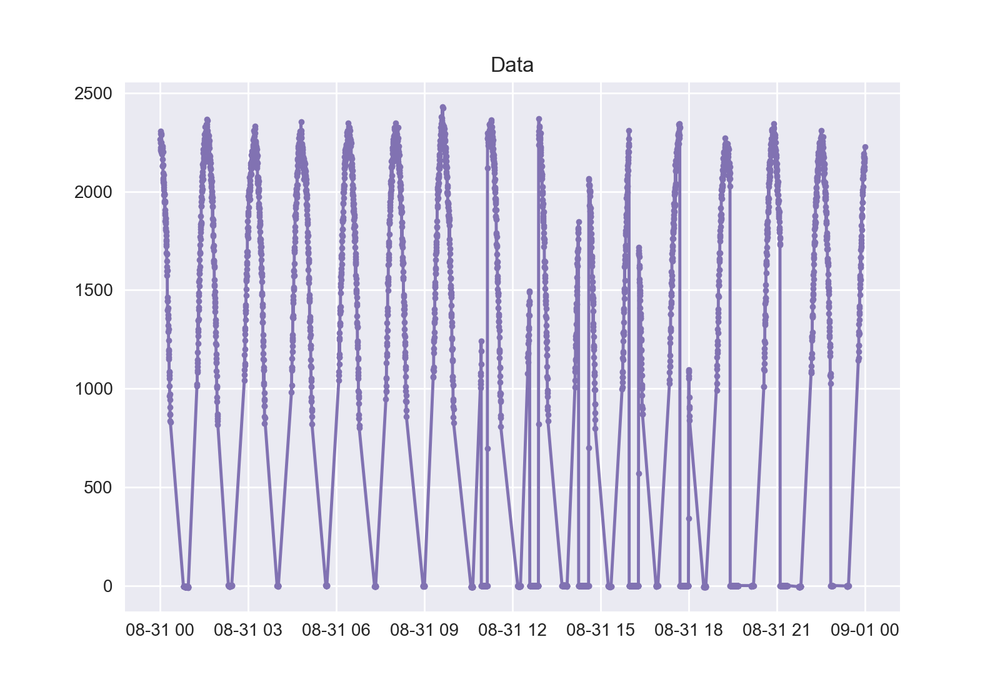

<IPython.core.display.Javascript object>


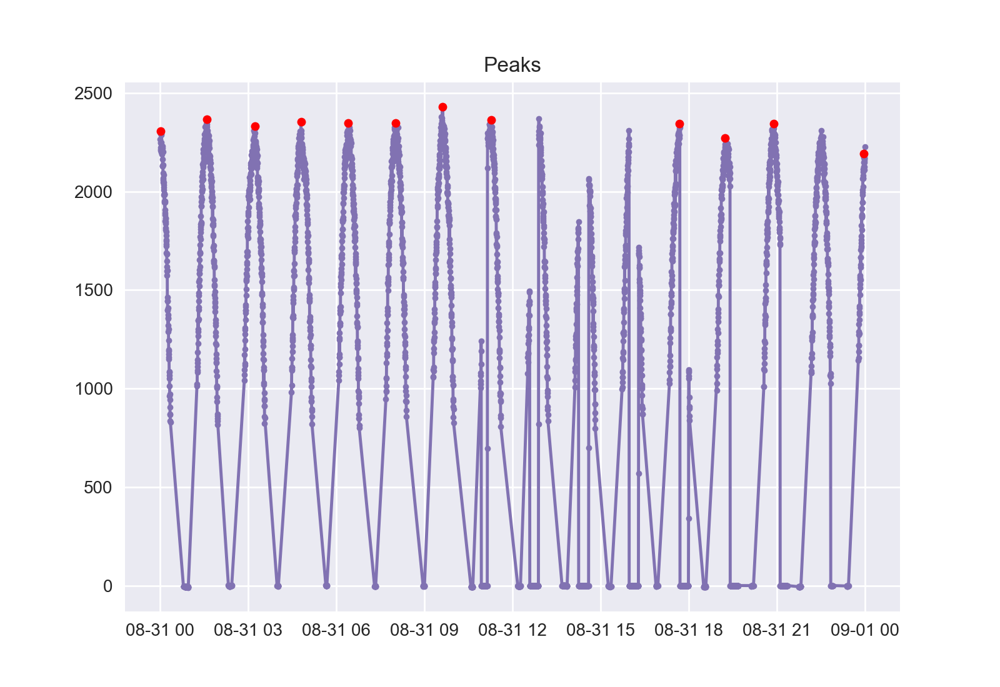

In [135]:
wave_peaks_tdf(df_831,59)

## EXTRACTING ORBITS

In [ ]:
# plus or minus a time delta for the x vals
# if it hits zero on either side, stop appending to the array

# plus or minus 20/30 minutes

#missing data- check to see if there's no data within a thirty second interval for a few points in a row, return 'bad orbit'

In [39]:
df = df_510
r = 148
df_plt = df.isel(row = r)
# plt.figure()
# plt.title('Data')
# plt.plot(df_plt.time, df_plt.I_1356, 'C3.-') 
# plt.show()

from scipy.signal import find_peaks
data = df.I_1356.isel(row = r)
data_np = data.to_numpy()
np.shape(data)

max_data = max(data_np)
time_diff = pd.to_timedelta('97 m')
print(time_diff)


indices = find_peaks(data, height = max_data * (4/6)) 

indexes = indices[0]
#print(indexes)
final_indexes = []

for i in range(0,len(indexes)-1):
    if len(indexes) > 15:
        if indexes[i+1] - indexes[i] < 200:
            pass
        else:
            final_indexes.append(indexes[i])
    else:
        final_indexes.append(indexes[i])
final_indexes.append(indexes[-1])
print(final_indexes)

times_np = df_plt.time.to_numpy()
times_dt = pd.to_datetime(times_np)

# Adding a delta (plus and minus) to each timestamp, and making sure they're above zero

start_times = []
#vals_at_times = []

for i in times_np:
    start_times.append(times_dt- time_diff)
    #times.append(times_dt)
    #times.append(times_dt + time_diff)

start_times

#df.sel(time = times)
#for timestamp in times:
    
# for i in final_indexes: 
#     times.append(times_np[i])
#     vals_at_times.append(data[i])
    
#     #i_range = np.arange(i-150,i+119)
#     for j in i_range:
#         times.append(times_np[j])
#         vals_at_times.append(data[j])


# df_plt = df.isel(row = r)
# plt.figure()
# plt.title('Peaks')
# plt.plot(df_plt.time, df_plt.I_1356, 'C3.-') 

# for i in range(0,len(times)):
#     plt.plot(times[i],vals_at_times[i],'ro', markersize = 5)
# plt.show()

    

0 days 01:37:00
[382, 858, 1322, 1786, 2268, 2734, 3210, 3672, 4148, 4619, 5087, 5554, 6026, 6495, 6964]


[DatetimeIndex(['2020-05-09 22:23:08.780000', '2020-05-09 22:23:21.085000',
                '2020-05-09 22:23:33.381000', '2020-05-09 22:23:45.684000',
                '2020-05-09 22:23:57.980000', '2020-05-09 22:24:10.285000',
                '2020-05-09 22:24:22.581000', '2020-05-09 22:24:34.884000',
                '2020-05-09 22:24:47.180000', '2020-05-09 22:24:59.484000',
                ...
                '2020-05-10 22:21:01.279000', '2020-05-10 22:21:13.582000',
                '2020-05-10 22:21:25.878000', '2020-05-10 22:21:38.183000',
                '2020-05-10 22:21:50.479000', '2020-05-10 22:22:02.782000',
                '2020-05-10 22:22:15.078000', '2020-05-10 22:22:27.381000',
                '2020-05-10 22:22:39.677000', '2020-05-10 22:22:51.982000'],
               dtype='datetime64[ns]', length=7012, freq=None),
 DatetimeIndex(['2020-05-09 22:23:08.780000', '2020-05-09 22:23:21.085000',
                '2020-05-09 22:23:33.381000', '2020-05-09 22:23:45.684000',
   

In [41]:
df
tstart = pd.to_datetime('2020-05-10 22:22:02.782000')
#tstop = pd.to_datetime('2020-05-10 22:22:51.982000')
tstop = tstart + pd.to_timedelta('97 min')
df_orbit = df.sel(time=slice(tstart, tstop))
df_orbit

<xarray.Dataset>
Dimensions:  (row: 256, time: 473)
Coordinates:
  * row      (row) float32 0.0 1.0 2.0 3.0 4.0 ... 251.0 252.0 253.0 254.0 255.0
  * time     (time) datetime64[ns] 2020-05-10T22:22:12.046000 ... 2020-05-10T...
Data variables:
    I_1356   (time, row) float32 ...
Attributes: (12/51)
    Acknowledgement:             This is a data product from the NASA Ionosph...
    ADID_Ref:                    NASA Contract > NNG12F45C
    Calibration_File:            See calibration files in general attribute f...
    Conventions:                 SPDF ISTP/IACF Modified for NetCDF (v0.8)
    Data_Level:                  L1
    Data_Type:                   APIDxE3 > ICON Application ID 0xE3: FUV Scie...
    ...                          ...
    FLATFIELD_CORRECTION:        [1.159 1.057 1.011 0.952 0.919 0.91 ]
    BACKGROUND_CORRECTION:       sw_bkg_2020-131.txt
    RAYLEIGH_CONVERSION:         [0.00284681 0.00284681 0.00284681 ... 0.0424...
    File_Date:                   Wed, 27 Apr 2022, 2022-04-27T18:35:25.208 UTC
    Generation_Date:             20220427
    Software_Version:            ICON SDC > ICON FUV L1 Processor version 202...

## INDIVIDUAL WAVE ANALYSIS

In [ ]:
#take one orbit of data that's good and apply the filtering and smoothing code from the start of this massive document to it

<IPython.core.display.Javascript object>


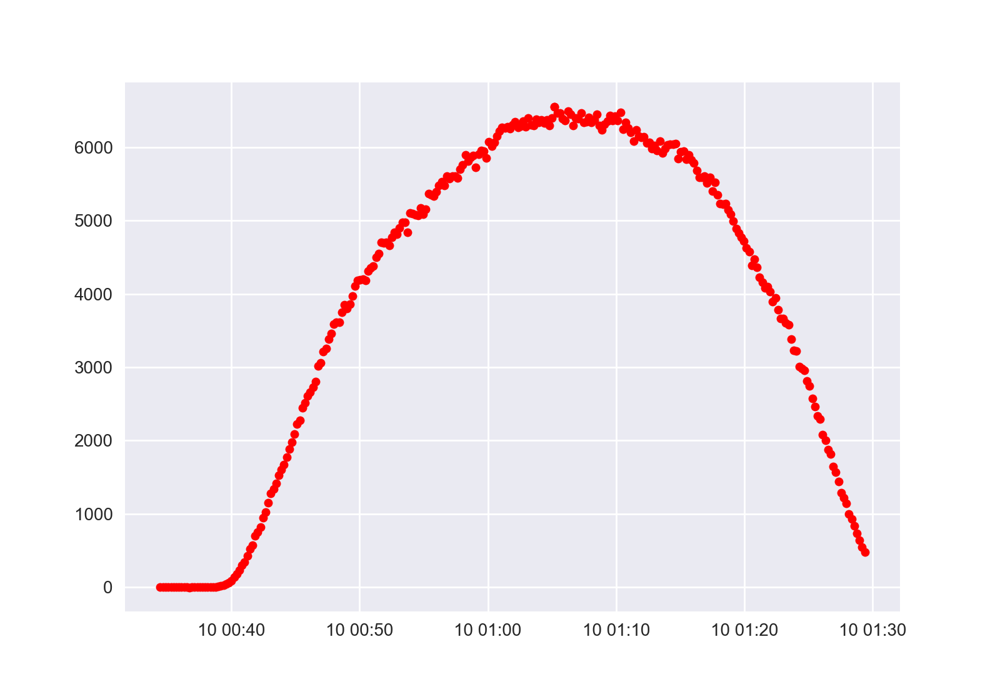

In [23]:
sel_times = []
sel_vals = []
plt.figure()
for i in range(0,int(len(times)/15)):
    sel_times.append(times[i])
    sel_vals.append(vals_at_times[i])
    plt.plot(times[i],vals_at_times[i],'ro', markersize = 5)
plt.show()


In [24]:
sel_vals

[<xarray.DataArray 'I_1356' ()>
 array(6557.8364, dtype=float32)
 Coordinates:
     row      float32 148.0
     time     datetime64[ns] 2020-05-10T01:05:12.667000
 Attributes: (12/19)
     TYPE:          float (4-bytes)
     CATDESC:       FUVA SW channel altitude column brightness for 0 to +3 deg...
     CONTENT:       FUVA SW channel altitude column brightness for 0 to +3 deg...
     DEPEND_0:      Epoch
     DEPEND_1:      Rows
     DISPLAY_TYPE:  spectrogram
     ...            ...
     VAR_TYPE:      data
     SCALETYP:      linear
     VAR_NOTES:     Vertical profile for 0 to +3 degrees FOV
     Valid_Min:     -1000000.0
     Valid_Max:     1000000.0
     Time_Base:     FIXED: 1970-01-01 UTC,
 <xarray.DataArray 'I_1356' ()>
 array(-3.121321, dtype=float32)
 Coordinates:
     row      float32 148.0
     time     datetime64[ns] 2020-05-10T00:34:26.453000
 Attributes: (12/19)
     TYPE:          float (4-bytes)
     CATDESC:       FUVA SW channel altitude column brightness for 0 to 

In [26]:
# pandas datetime

numpy.datetime64('2020-05-10T01:05:12.667000000')

In [25]:
#FILTERING
dsf['I_1356_filt'] = dsf['I_1356'] - dsf['I_1356'].rolling(time=17, center=True).mean() 

filt_vals = sel_vals - sel_vals.rolling(time=17, center=True).mean() # Remove ~3.5 minute (17-sample) rolling mean (FUV samples @ 12 sec)

# Which data to plot

plt.figure(figsize=(10,5))

# # FUV
# vm = abs(dsf_plot.I_1356_filt).quantile(0.99) # Choose max of colorbar (i.e., contrast)
# plt.pcolormesh(pd.to_datetime(sel_times.values), sel_values.row, dsf_plot.I_1356_filt.T, cmap='plasma', vmin=-vm, vmax=vm)
# plt.ylabel('row')
# plt.colorbar(label='R??')
# plt.title('FUV 1356 brightness')


# plt.gcf().autofmt_xdate()
# # plt.colorbar(
# plt.show()

AttributeError: 'list' object has no attribute 'rolling'

<IPython.core.display.Javascript object>


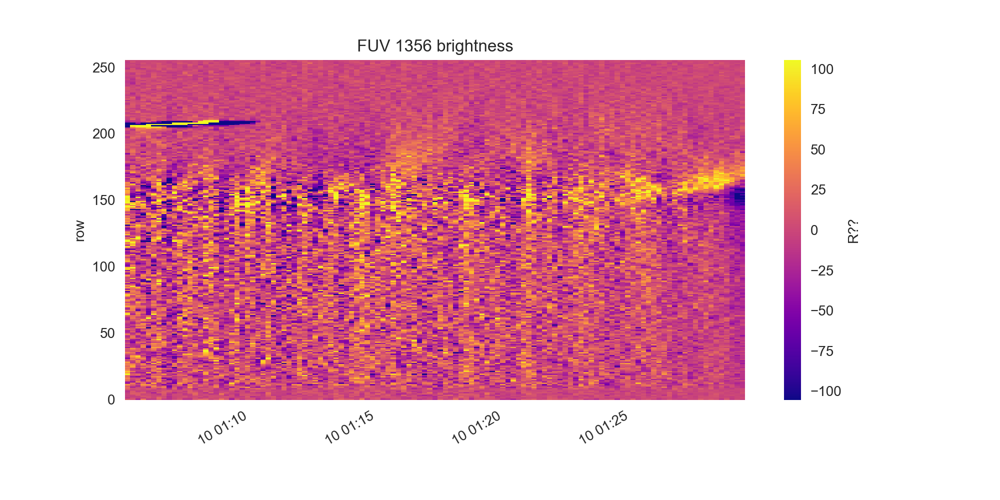

In [28]:
#FILTERING
df['I_1356_filt'] = df['I_1356'] - df['I_1356'].rolling(time=17, center=True).mean() # Remove ~3.5 minute (17-sample) rolling mean (FUV samples @ 12 sec)

# Which data to plot
start = str(sel_times[0])
stop = str(sel_times[-1])

dsf_plot = df.sel(time=slice(start, stop))

plt.figure(figsize=(10,5))

# FUV
vm = abs(dsf_plot.I_1356_filt).quantile(0.99) # Choose max of colorbar (i.e., contrast)
plt.pcolormesh(pd.to_datetime(dsf_plot.time.values), dsf_plot.row, dsf_plot.I_1356_filt.T, cmap='plasma', vmin=-vm, vmax=vm)
plt.ylabel('row')
plt.colorbar(label='R??')
plt.title('FUV 1356 brightness')


plt.gcf().autofmt_xdate()
# plt.colorbar(
plt.show()

<IPython.core.display.Javascript object>


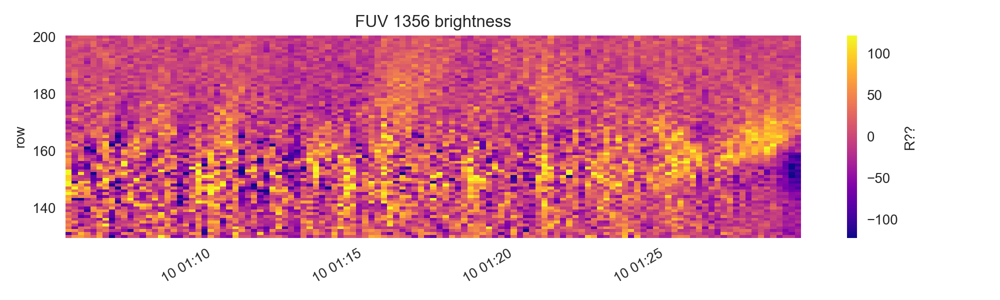

In [29]:
# Alt Match
# Which data to plot
dsf_plot = df.sel(time=slice(start, stop), row=slice(130,200))

plt.figure(figsize=(10,3))
vm = abs(dsf_plot.I_1356_filt).quantile(0.99) # Choose max of colorbar (i.e., contrast)
plt.pcolormesh(pd.to_datetime(dsf_plot.time.values), dsf_plot.row, dsf_plot.I_1356_filt.T, cmap='plasma', vmin=-vm, vmax=vm)
plt.ylabel('row')
plt.colorbar(label='R??')
plt.title('FUV 1356 brightness')

plt.gcf().autofmt_xdate()
plt.tight_layout()


<IPython.core.display.Javascript object>


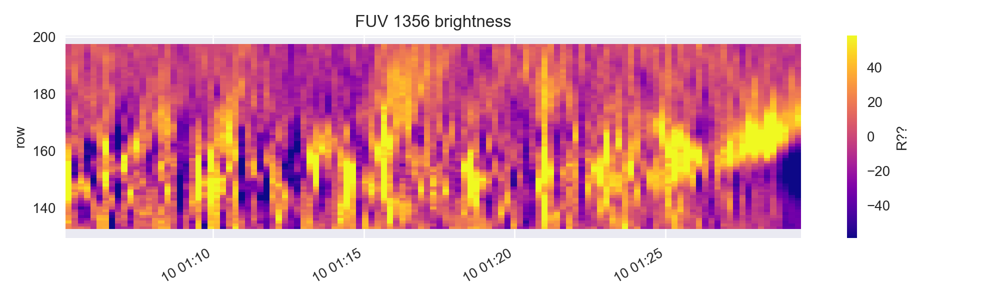

In [30]:
#SMOOTHED
# Which data to plot
dsf_plot = df.sel(time=slice(start, stop), row=slice(130,200))
dsf_plot = dsf_plot.rolling(row=7, center=True).mean()

plt.figure(figsize=(10,3))

# FUV
vm = abs(dsf_plot.I_1356_filt).quantile(0.95) # Choose max of colorbar (i.e., contrast)
plt.pcolormesh(pd.to_datetime(dsf_plot.time.values), dsf_plot.row, dsf_plot.I_1356_filt.T, cmap='plasma', vmin=-vm, vmax=vm)
plt.ylabel('row')
plt.colorbar(label='R??')
plt.title('FUV 1356 brightness')

plt.gcf().autofmt_xdate()
plt.tight_layout()

In [ ]:
# PCA Based filtering, use a bunch of different orbits, create 2D features